<a href="https://colab.research.google.com/github/asole91/retina-unet/blob/master/last_orobix_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CONNECTIVITY AND MODULES

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Load all source codes from orobix:

Indicate the root folder from your drive:

In [ ]:
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/extract_patches.py extract_patches.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/help_functions.py help_functions.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/pre_processing.py pre_processing.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/run_testing.py run_testing.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/run_training.py run_training.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/run_WB_training.py run_WB_training.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/WHITE_BAND_training.py WHITE_BAND_training.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/retinaNN_training.py retinaNN_training.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/retinaNN_predict.py retinaNN_predict.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/retinaNN_predict_real.py retinaNN_predict_real.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/prepare_datasets_DRIVE.py prepare_datasets_DRIVE.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/prepare_datasets_REAL.py prepare_datasets_REAL.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/masks_creation.py masks_creation.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/Noise_Cleaning.py Noise_Cleaning.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/Images_Cleaning.py Images_Cleaning.py
!cp /content/gdrive/MyDrive/test_orobix/orobix_colab/skeleton_functions.py skeleton_functions.py


import extract_patches
import help_functions
import pre_processing
import run_testing
import run_training
import Noise_Cleaning
import skeleton_functions

import skimage as sk
import os
from help_functions import Mask_Prod, Compacting


1. Create directory for the results (if not already existing)

2. Run the prediction on GPU (no nohup)

1. Create directory for the results (if not already existing)
Dir already existing
copy the configuration file in the results folder

2. Run the training on GPU with nohup


# MODEL PREPARATION

## RUN DATA PREPARATION 

prepare_datasets_DRIVE.py



In [ ]:
import os
import h5py
import numpy as np
from PIL import Image
import skimage as sk 



def write_hdf5(arr,outfile):
  with h5py.File(outfile,"w") as f:
    f.create_dataset("image", data=arr, dtype=arr.dtype)


#------------Path of the images --------------------------------------------------------------
root_path = "/content/gdrive/MyDrive/test_orobix/"
#train
original_imgs_train = root_path + "DRIVE/training/images"
groundTruth_imgs_train = root_path + "DRIVE/training/1st_manual"
borderMasks_imgs_train = root_path + "DRIVE/training/mask"
#test
original_imgs_test = root_path + "DRIVE/test/images"
groundTruth_imgs_test = root_path + "DRIVE/test/1st_manual"
borderMasks_imgs_test = root_path + "DRIVE/test/mask"
#---------------------------------------------------------------------------------------------

Nimgs = 20
NimgsT = 2
channels = 3
height = 480
width = 640
dataset_path = root_path + "orobix_colab/DRIVE_datasets_training_testing"

def get_datasets(imgs_dir,groundTruth_dir,borderMasks_dir,Nimgs,train_test="null"):
    imgs = np.empty((Nimgs,height,width,channels))
    groundTruth = np.empty((Nimgs,height,width))
    border_masks = np.empty((Nimgs,height,width))
    for path, subdirs, files in os.walk(imgs_dir): #list all files, directories in the path
        for i in range(len(files)):
            #original
            print("original image: " +files[i])
            img = Image.open(imgs_dir+'/'+files[i])
            imgs[i] = np.asarray(img)
            #corresponding ground truth
            groundTruth_name = files[i][0:2] + "_manual1.gif"
            print("ground truth name: " + groundTruth_name)

            #g_truth = Image.open(groundTruth_dir +'/'+ groundTruth_name)
            #groundTruth[i] = np.asarray(g_truth)

            g_truth = sk.io.imread(groundTruth_dir +'/'+ groundTruth_name)
            groundTruth[i] = g_truth

            #corresponding border masks
            border_masks_name = ""
            if train_test=="train":
                border_masks_name = files[i][0:2] + "_training_mask.gif"
            elif train_test=="test":
                border_masks_name = files[i][0:2] + "_test_mask.gif"
            else:
                print("specify if train or test!!")
                exit()
            print("border masks name: " + border_masks_name)
            #b_mask = Image.open(borderMasks_dir + '/'+border_masks_name)
            #border_masks[i] = np.asarray(b_mask)
            b_mask = sk.io.imread(borderMasks_dir + '/'+border_masks_name)
            border_masks[i] = b_mask

    print("imgs max: " +str(np.max(imgs)))
    print("imgs min: " +str(np.min(imgs)))
    print("masks max: " +str(np.max(border_masks)))
    print("masks min: " +str(np.min(border_masks)))
    print("GTs max: " +str(np.max(groundTruth)))
    print("GTs min: " +str(np.min(groundTruth)))
    assert(np.max(groundTruth)==255 and np.max(border_masks)==255)
    assert(np.min(groundTruth)==0 and np.min(border_masks)==0)
    print("ground truth and border masks are correctly withih pixel value range 0-255 (black-white)")
    #reshaping for my standard tensors
    imgs = np.transpose(imgs,(0,3,1,2))
    assert(imgs.shape == (Nimgs,channels,height,width))
    groundTruth = np.reshape(groundTruth,(Nimgs,1,height,width))
    border_masks = np.reshape(border_masks,(Nimgs,1,height,width))
    assert(groundTruth.shape == (Nimgs,1,height,width))
    assert(border_masks.shape == (Nimgs,1,height,width))
    return imgs, groundTruth, border_masks

if not os.path.exists(dataset_path):
    os.makedirs(dataset_path)

#getting the training datasets
imgs_train, groundTruth_train, border_masks_train = get_datasets(original_imgs_train,groundTruth_imgs_train,borderMasks_imgs_train,Nimgs,"train")
print("saving train datasets")
write_hdf5(imgs_train, dataset_path +'/' + "DRIVE_dataset_imgs_train.hdf5")
write_hdf5(groundTruth_train, dataset_path + '/' + "DRIVE_dataset_groundTruth_train.hdf5")
write_hdf5(border_masks_train,dataset_path + '/' + "DRIVE_dataset_borderMasks_train.hdf5")

#getting the testing datasets
imgs_test, groundTruth_test, border_masks_test = get_datasets(original_imgs_test,groundTruth_imgs_test,borderMasks_imgs_test,NimgsT,"test")
print("saving test datasets")
write_hdf5(imgs_test,dataset_path +'/'+ "DRIVE_dataset_imgs_test.hdf5")
write_hdf5(groundTruth_test, dataset_path +'/'+ "DRIVE_dataset_groundTruth_test.hdf5")
write_hdf5(border_masks_test,dataset_path + '/' + "DRIVE_dataset_borderMasks_test.hdf5")

original image: 22_training.tif


ValueError: ignored

## RUN TRAINING 



In [ ]:
import retinaNN_training

(20, 1, 480, 640)
(20, 1, 480, 640)
(20, 1, 480, 480)
(20, 1, 480, 480)

train images/masks shape:
(20, 1, 480, 480)
train images range (min-max): 0.00392156862745098 - 0.996078431372549
train masks are within 0-1

patches per full image: 9500

train PATCHES images/masks shape:
(190000, 1, 48, 48)
train PATCHES images range (min-max): 0.00392156862745098 - 0.996078431372549
Check: final output of the network:
(None, 2304, 2)
Epoch 1/150
5344/5344 - 135s - loss: 0.0484 - accuracy: 0.9928 - val_loss: 0.0835 - val_accuracy: 0.9854

Epoch 00001: val_loss improved from inf to 0.08352, saving model to /content/gdrive/MyDrive/test_orobix/orobix_colab/test/test_best_weights.h5
Epoch 2/150
5344/5344 - 102s - loss: 0.0389 - accuracy: 0.9937 - val_loss: 0.0858 - val_accuracy: 0.9854

Epoch 00002: val_loss did not improve from 0.08352
Epoch 3/150
5344/5344 - 102s - loss: 0.0380 - accuracy: 0.9937 - val_loss: 0.0842 - val_accuracy: 0.9854

Epoch 00003: val_loss did not improve from 0.08352
Epoch 4/

## RUN PREDICTION & TEST


In [ ]:
###################################################
#
#   Script to
#   - Calculate prediction of the test dataset
#   - Calculate the parameters to evaluate the prediction
#
##################################################

#Python
import numpy as np
import configparser as ConfigParser
from matplotlib import pyplot as plt
#Keras
from keras.models import model_from_json
from keras.models import Model
#scikit learn
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
import sys
sys.path.insert(0, './lib/')
# help_functions.py
from help_functions import *
# extract_patches.py
from extract_patches import recompone
from extract_patches import recompone_overlap
from extract_patches import paint_border
from extract_patches import kill_border
from extract_patches import pred_only_FOV
from extract_patches import get_data_testing
from extract_patches import get_data_testing_overlap
# pre_processing.py
from pre_processing import my_PreProc


#========= CONFIG FILE TO READ FROM =======
config = ConfigParser.RawConfigParser()

config.read('/content/gdrive/MyDrive/test_orobix/orobix_colab/configuration.txt')
#===========================================
#run the training on invariant or local
path_data = config.get('data paths', 'path_local')

#original test images (for FOV selection)
DRIVE_test_imgs_original = path_data + config.get('data paths', 'test_imgs_original')
print()
test_imgs_orig = load_hdf5(DRIVE_test_imgs_original)
full_img_height = test_imgs_orig.shape[2]
full_img_width = test_imgs_orig.shape[3]
#the border masks provided by the DRIVE
DRIVE_test_border_masks = path_data + config.get('data paths', 'test_border_masks')
test_border_masks = load_hdf5(DRIVE_test_border_masks)
print(DRIVE_test_border_masks)
print(test_border_masks.shape)
# dimension of the patches
patch_height = int(config.get('data attributes', 'patch_height'))
patch_width = int(config.get('data attributes', 'patch_width'))
#the stride in case output with average
stride_height = int(config.get('testing settings', 'stride_height'))
stride_width = int(config.get('testing settings', 'stride_width'))
assert (stride_height < patch_height and stride_width < patch_width)
#model name
name_experiment = config.get('experiment name', 'name')
path_experiment = '/content/gdrive/MyDrive/test_orobix/orobix_colab/' +name_experiment +'/'
#N full images to be predicted
Imgs_to_test = int(config.get('testing settings', 'full_images_to_test'))
#Grouping of the predicted images
N_visual = int(config.get('testing settings', 'N_group_visual'))
#====== average mode ===========
average_mode = config.getboolean('testing settings', 'average_mode')


# #ground truth
# gtruth= path_data + config.get('data paths', 'test_groundTruth')
# img_truth= load_hdf5(gtruth)
# visualize(group_images(test_imgs_orig[0:20,:,:,:],5),'original')#.show()
# visualize(group_images(test_border_masks[0:20,:,:,:],5),'borders')#.show()
# visualize(group_images(img_truth[0:20,:,:,:],5),'gtruth')#.show()



#============ Load the data and divide in patches
patches_imgs_test = None
new_height = None
new_width = None
masks_test  = None
patches_masks_test = None
if average_mode == True:
    patches_imgs_test, new_height, new_width, masks_test = get_data_testing_overlap(
        DRIVE_test_imgs_original = DRIVE_test_imgs_original,  #original
        DRIVE_test_groudTruth = path_data + config.get('data paths', 'test_groundTruth'),  #masks
        Imgs_to_test = int(config.get('testing settings', 'full_images_to_test')),
        patch_height = patch_height,
        patch_width = patch_width,
        stride_height = stride_height,
        stride_width = stride_width
    )
else:
    patches_imgs_test, patches_masks_test = get_data_testing(
        DRIVE_test_imgs_original = DRIVE_test_imgs_original,  #original
        DRIVE_test_groudTruth = path_data + config.get('data paths', 'test_groundTruth'),  #masks
        Imgs_to_test = int(config.get('testing settings', 'full_images_to_test')),
        patch_height = patch_height,
        patch_width = patch_width,
    )



#================ Run the prediction of the patches ==================================
best_last = config.get('testing settings', 'best_last')
#Load the saved model
model = model_from_json(open(path_experiment+name_experiment +'_architecture.json').read())
model.load_weights(path_experiment+name_experiment + '_'+best_last+'_weights.h5')
#Calculate the predictions
predictions = model.predict(patches_imgs_test, batch_size=32, verbose=2)
print("predicted images size :")
print(predictions.shape)

#===== Convert the prediction arrays in corresponding images
pred_patches = pred_to_imgs(predictions, patch_height, patch_width, "original")
#========== Elaborate and visualize the predicted images ====================
pred_imgs = None
orig_imgs = None
gtruth_masks = None
if average_mode == True:
    pred_imgs = recompone_overlap(pred_patches, new_height, new_width, stride_height, stride_width)# predictions
    orig_imgs = my_PreProc(test_imgs_orig[0:pred_imgs.shape[0],:,:,:])    #originals
    gtruth_masks = masks_test  #ground truth masks
else:
    pred_imgs = recompone(pred_patches,13,12)       # predictions
    orig_imgs = recompone(patches_imgs_test,13,12)  # originals
    gtruth_masks = recompone(patches_masks_test,13,12)  #masks

# apply the DRIVE masks on the repdictions #set everything outside the FOV to zero!!
kill_border(pred_imgs, test_border_masks)  #DRIVE MASK  #only for visualization
## back to original dimensions
orig_imgs = orig_imgs[:,:,0:full_img_height,0:full_img_width]
pred_imgs = pred_imgs[:,:,0:full_img_height,0:full_img_width]
gtruth_masks = gtruth_masks[:,:,0:full_img_height,0:full_img_width]

print(pred_imgs.shape)
print("min",np.min(pred_imgs[0,0,:,:]))
print("max",np.max(pred_imgs[0,0,:,:]))
print("min",np.min(pred_imgs[1,0,:,:]))
print("max",np.max(pred_imgs[1,0,:,:]))
print("type",pred_imgs.dtype)
print("N visual",N_visual)

print("Orig imgs shape: " +str(orig_imgs.shape))
print("pred imgs shape: " +str(pred_imgs.shape))
print("Gtruth imgs shape: " +str(gtruth_masks.shape))

visualize(group_images(orig_imgs,N_visual),path_experiment+"all_originals")#.show()
visualize(group_images(pred_imgs,N_visual),path_experiment+"all_predictions")#.show()
visualize(group_images(gtruth_masks,N_visual),path_experiment+"all_groundTruths")#.show()
#visualize results comparing mask and prediction:
assert (orig_imgs.shape[0]==pred_imgs.shape[0] and orig_imgs.shape[0]==gtruth_masks.shape[0])
N_predicted = orig_imgs.shape[0]
group = N_visual
assert (N_predicted%group==0)
for i in range(int(N_predicted/group)):
    orig_stripe = group_images(orig_imgs[i*group:(i*group)+group,:,:,:],group)
    masks_stripe = group_images(gtruth_masks[i*group:(i*group)+group,:,:,:],group)
    pred_stripe = group_images(pred_imgs[i*group:(i*group)+group,:,:,:],group)
    total_img = np.concatenate((orig_stripe,masks_stripe,pred_stripe),axis=0)
    visualize(total_img,path_experiment+name_experiment +"_Original_GroundTruth_Prediction"+str(i))#.show()


#====== Evaluate the results
print("\n\n========  Evaluate the results =======================")
#predictions only inside the FOV

y_scores, y_true = pred_only_FOV(pred_imgs,gtruth_masks, test_border_masks)  #returns data only inside the FOV
y_true = y_true.astype(bool) #correction WB
print("Calculating results only inside the FOV:")
print("y scores pixels: " +str(y_scores.shape[0]) +" (radius 270: 270*270*3.14==228906), including background around retina: " +str(pred_imgs.shape[0]*pred_imgs.shape[2]*pred_imgs.shape[3]) +" (584*565==329960)")
print("y true pixels: " +str(y_true.shape[0]) +" (radius 270: 270*270*3.14==228906), including background around retina: " +str(gtruth_masks.shape[2]*gtruth_masks.shape[3]*gtruth_masks.shape[0])+" (584*565==329960)")

#Area under the ROC curve
print(y_true)
print(y_scores)
fpr, tpr, thresholds = roc_curve(y_true, y_scores)
AUC_ROC = roc_auc_score(y_true, y_scores)
# test_integral = np.trapz(tpr,fpr) #trapz is numpy integration
print("\nArea under the ROC curve: " +str(AUC_ROC))
roc_curve =plt.figure()
plt.plot(fpr,tpr,'-',label='Area Under the Curve (AUC = %0.4f)' % AUC_ROC)
plt.title('ROC curve')
plt.xlabel("FPR (False Positive Rate)")
plt.ylabel("TPR (True Positive Rate)")
plt.legend(loc="lower right")
plt.savefig(path_experiment+"ROC.png")

#Precision-recall curve
precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
precision = np.fliplr([precision])[0]  #so the array is increasing (you won't get negative AUC)
recall = np.fliplr([recall])[0]  #so the array is increasing (you won't get negative AUC)
AUC_prec_rec = np.trapz(precision,recall)
print("\nArea under Precision-Recall curve: " +str(AUC_prec_rec))
prec_rec_curve = plt.figure()
plt.plot(recall,precision,'-',label='Area Under the Curve (AUC = %0.4f)' % AUC_prec_rec)
plt.title('Precision - Recall curve')
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.legend(loc="lower right")
plt.savefig(path_experiment+"Precision_recall.png")

#Confusion matrix
threshold_confusion = 0.5
print("\nConfusion matrix:  Custom threshold (for positive) of " +str(threshold_confusion))
y_pred = np.empty((y_scores.shape[0]))
for i in range(y_scores.shape[0]):
    if y_scores[i]>=threshold_confusion:
        y_pred[i]=1
    else:
        y_pred[i]=0
confusion = confusion_matrix(y_true, y_pred)
print(confusion)
accuracy = 0
if float(np.sum(confusion))!=0:
    accuracy = float(confusion[0,0]+confusion[1,1])/float(np.sum(confusion))
print("Global Accuracy: " +str(accuracy))
specificity = 0
if float(confusion[0,0]+confusion[0,1])!=0:
    specificity = float(confusion[0,0])/float(confusion[0,0]+confusion[0,1])
print("Specificity: " +str(specificity))
sensitivity = 0
if float(confusion[1,1]+confusion[1,0])!=0:
    sensitivity = float(confusion[1,1])/float(confusion[1,1]+confusion[1,0])
print("Sensitivity: " +str(sensitivity))
precision = 0
if float(confusion[1,1]+confusion[0,1])!=0:
    precision = float(confusion[1,1])/float(confusion[1,1]+confusion[0,1])
print("Precision: " +str(precision))

#Jaccard similarity index
jaccard_index = jaccard_similarity_score(y_true, y_pred, normalize=True)
print("\nJaccard similarity score: " +str(jaccard_index))

#F1 score
F1_score = f1_score(y_true, y_pred, labels=None, average='binary', sample_weight=None)
print("\nF1 score (F-measure): " +str(F1_score))

#Save the results
file_perf = open(path_experiment+'performances.txt', 'w')
file_perf.write("Area under the ROC curve: "+str(AUC_ROC)
                + "\nArea under Precision-Recall curve: " +str(AUC_prec_rec)
                + "\nJaccard similarity score: " +str(jaccard_index)
                + "\nF1 score (F-measure): " +str(F1_score)
                +"\n\nConfusion matrix:"
                +str(confusion)
                +"\nACCURACY: " +str(accuracy)
                +"\nSENSITIVITY: " +str(sensitivity)
                +"\nSPECIFICITY: " +str(specificity)
                +"\nPRECISION: " +str(precision)
                )
file_perf.close()


ModuleNotFoundError: ignored

In [ ]:
print(y_true)
print(np.min(y_true))
print(np.max(y_true))
print(type(y_true))
print(y_true.shape)

print(y_scores)
print(np.min(y_scores))
print(np.max(y_scores))
print(type(y_scores))
print(y_true.shape)

AUC_ROC = roc_auc_score(y_true.astype(bool), y_scores)

# REAL IMAGES PREDICTION

## MASKS CREATION 

In [ ]:
Mask_Prod("/content/gdrive/MyDrive/test_orobix/REAL/test")

Mask name: 2_test_mask.gif
Mask name: 4_test_mask.gif
Mask name: 7_test_mask.gif
Mask name: 8_test_mask.gif
Mask name: 5_test_mask.gif
Mask name: 3_test_mask.gif
Mask name: 1_test_mask.gif
Mask name: 6_test_mask.gif
Mask name: 9_test_mask.gif
Mask name: 10_test_mask.gif
Masks saved


## RUN DATA PREPARATION REAL

prepare_datasets_REAL.py

In [ ]:
import os
import h5py
import numpy as np
from PIL import Image
import skimage as sk 
from skimage import img_as_int,img_as_float,io


def write_hdf5(arr,outfile):
  with h5py.File(outfile,"w") as f:
    f.create_dataset("image", data=arr, dtype=arr.dtype)


#------------Path of the images --------------------------------------------------------------
root_path = "/content/gdrive/MyDrive/test_orobix/"

#test
original_imgs_test = root_path + "REAL/test/images"
borderMasks_imgs_test = root_path + "REAL/test/mask"
#---------------------------------------------------------------------------------------------

Nimgs = 10
channels = 3
height = 480
width = 640
dataset_path = root_path + "orobix_colab/REAL_datasets_testing"



def get_datasets(imgs_dir,borderMasks_dir,train_test="null"):
    imgs = np.empty((Nimgs,height,width,channels))
    border_masks = np.empty((Nimgs,height,width))
    for path, subdirs, files in os.walk(imgs_dir): #list all files, directories in the path
        print(len(files))
        for i in range(len(files)):
            #original
            print("original image: " +files[i])
            img = Image.open(imgs_dir+"/"+files[i])
            imgs[i] = np.asarray(img)
            #corresponding border masks
            border_masks_name = files[i][0:2] + "test_mask.gif"
            if (files[i][2]=='_'):
              border_masks_name = files[i][0:3] + "test_mask.gif"
            if (files[i][3]=='_'):
              border_masks_name = files[i][0:4] + "test_mask.gif"
            print("border masks name: " + border_masks_name)
            b_mask = sk.io.imread(borderMasks_dir + "/"+border_masks_name)
            border_masks[i] = b_mask

    print("imgs max: " +str(np.max(imgs)))
    print("imgs min: " +str(np.min(imgs)))
    assert(np.max(border_masks)==255)
    assert(np.min(border_masks)==0)
    print("border masks are correctly withih pixel value range 0-255 (black-white)")
    #reshaping for my standard tensors
    imgs = np.transpose(imgs,(0,3,1,2))
    assert(imgs.shape == (Nimgs,channels,height,width))
    border_masks = np.reshape(border_masks,(Nimgs,1,height,width))
    assert(border_masks.shape == (Nimgs,1,height,width))
    return imgs, border_masks

if not os.path.exists(dataset_path):
    os.makedirs(dataset_path)
#getting the testing datasets
imgs_test, border_masks_test = get_datasets(original_imgs_test,borderMasks_imgs_test,"test")
print("saving test datasets")
write_hdf5(imgs_test,dataset_path +'/'+ "REAL_dataset_imgs_test.hdf5")
write_hdf5(border_masks_test,dataset_path + '/' + "REAL_dataset_borderMasks_test.hdf5")

10
original image: 2_test.jpg
border masks name: 2_test_mask.gif
original image: 4_test.jpg
border masks name: 4_test_mask.gif
original image: 7_test.jpg
border masks name: 7_test_mask.gif
original image: 8_test.jpg
border masks name: 8_test_mask.gif
original image: 5_test.jpg
border masks name: 5_test_mask.gif
original image: 3_test.jpg
border masks name: 3_test_mask.gif
original image: 1_test.jpg
border masks name: 1_test_mask.gif
original image: 6_test.jpg
border masks name: 6_test_mask.gif
original image: 9_test.jpg
border masks name: 9_test_mask.gif
original image: 10_test.jpg
border masks name: 10_test_mask.gif
imgs max: 255.0
imgs min: 0.0
border masks are correctly withih pixel value range 0-255 (black-white)
saving test datasets


## RUN PREDICTION REAL

In [ ]:
#import retinaNN_predict_real
import numpy as np
import os
import configparser as ConfigParser
from matplotlib import pyplot as plt
import skimage.io as io
#Keras
from keras.models import model_from_json
from keras.models import Model
#scikit learn
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
import sys
sys.path.insert(0, './lib/')
# help_functions.py
from help_functions import *
# extract_patches.py
from extract_patches import recompone
from extract_patches import recompone_overlap
from extract_patches import paint_border
from extract_patches import kill_border
from extract_patches import pred_only_FOV
from extract_patches import get_data_testing
from extract_patches import get_data_testing_overlap
from extract_patches import get_data_testing_real
from extract_patches import get_data_testing_overlap_real
# pre_processing.py
from pre_processing import my_PreProc


#========= CONFIG FILE TO READ FROM =======
config = ConfigParser.RawConfigParser()

config.read('/content/gdrive/MyDrive/test_orobix/orobix_colab/configuration.txt')
#===========================================
#run the training on invariant or local
path_data = config.get('data paths', 'path_local_REAL')
#obtain final folder path for resultant images
output_path = config.get('data paths', 'pred_res_path')
#original test images (for FOV selection)
REAL_test_imgs_original = path_data + config.get('data paths', 'test_imgs_original_REAL')
test_imgs_orig = load_hdf5(REAL_test_imgs_original)
full_img_height = test_imgs_orig.shape[2]
full_img_width = test_imgs_orig.shape[3]
#the border masks provided by masks_creation
REAL_test_border_masks = path_data + config.get('data paths', 'test_border_masks_REAL')
test_border_masks = load_hdf5(REAL_test_border_masks)
# dimension of the patches
patch_height = int(config.get('data attributes', 'patch_height'))
patch_width = int(config.get('data attributes', 'patch_width'))
#the stride in case output with average
stride_height = int(config.get('testing settings', 'stride_height'))
stride_width = int(config.get('testing settings', 'stride_width'))
assert (stride_height < patch_height and stride_width < patch_width)
#model name
name_experiment = config.get('experiment name', 'name_REAL')
path_experiment = '/content/gdrive/MyDrive/test_orobix/orobix_colab/' +name_experiment +'/'
#N full images to be predicted
Imgs_to_test = int(config.get('testing settings', 'full_images_to_test_REAL'))
#Grouping of the predicted images
N_visual = int(config.get('testing settings', 'N_group_visual'))
#====== average mode ===========
average_mode = config.getboolean('testing settings', 'average_mode')

#============ Load the data and divide in patches
patches_imgs_test = None
new_height = None
new_width = None
masks_test  = None
patches_masks_test = None
if average_mode == True:
    patches_imgs_test, new_height, new_width = get_data_testing_overlap_real(
        REAL_test_imgs_original = REAL_test_imgs_original,  #original
        Imgs_to_test = int(config.get('testing settings', 'full_images_to_test_REAL')),
        patch_height = patch_height,
        patch_width = patch_width,
        stride_height = stride_height,
        stride_width = stride_width
    )
else:
    patches_imgs_test = get_data_testing_real(
        REAL_test_imgs_original = REAL_test_imgs_original,  #original
        Imgs_to_test = int(config.get('testing settings', 'full_images_to_test_REAL')),
        patch_height = patch_height,
        patch_width = patch_width,
    )



#================ Run the prediction of the patches ==================================
best_last = config.get('testing settings', 'best_last')
#Load the saved model

#name_experiment_DRIVE = config.get('experiment name', 'name')
#path_experiment_DRIVE = '/content/gdrive/MyDrive/test_orobix/orobix_colab/' +name_experiment_DRIVE +'/'

model = model_from_json(open(path_experiment+name_experiment +'_architecture.json').read())
model.load_weights(path_experiment+name_experiment + '_'+best_last+'_weights.h5')
#Calculate the predictions
predictions = model.predict(patches_imgs_test, batch_size=32, verbose=2)
print("predicted images size :")
print(predictions.shape)

#===== Convert the prediction arrays in corresponding images
pred_patches = pred_to_imgs(predictions, patch_height, patch_width, "original")

#========== Elaborate and visualize the predicted images ====================
pred_imgs = None
orig_imgs = None
if average_mode == True:
    pred_imgs = recompone_overlap(pred_patches, new_height, new_width, stride_height, stride_width)# predictions

    
    orig_imgs = my_PreProc(test_imgs_orig[0:pred_imgs.shape[0],:,:,:])    #originals
else:
    pred_imgs = recompone(pred_patches,13,12)       # predictions
    orig_imgs = recompone(patches_imgs_test,13,12)  # originals
# apply the DRIVE masks on the repdictions #set everything outside the FOV to zero!!
kill_border(pred_imgs, test_border_masks)  #created MASK  #only for visualization
## back to original dimensions

orig_imgs = orig_imgs[:,:,0:full_img_height,0:full_img_width]
pred_imgs = pred_imgs[:,:,0:full_img_height,0:full_img_width]
print("Orig imgs shape: " +str(orig_imgs.shape))
print("pred imgs shape: " +str(pred_imgs.shape))

imgs = pred_imgs.copy()
for ni in range(imgs.shape[0]):
  img_P = os.path.join(output_path,str(ni+1)+'_pred.jpg')
  img_o = imgs[ni,0,:,:]*255
  io.imsave(img_P,img_o)
    
visualize(group_images(orig_imgs,N_visual),path_experiment+"all_originals")#.show()
visualize(group_images(pred_imgs,N_visual),path_experiment+"all_predictions")#.show()
#visualize results comparing mask and prediction:
assert (orig_imgs.shape[0]==pred_imgs.shape[0])
N_predicted = orig_imgs.shape[0]
group = N_visual
assert (N_predicted%group==0)
for i in range(int(N_predicted/group)):
    orig_stripe = group_images(orig_imgs[i*group:(i*group)+group,:,:,:],group)
    pred_stripe = group_images(pred_imgs[i*group:(i*group)+group,:,:,:],group)
    total_img = np.concatenate((orig_stripe,pred_stripe),axis=0)
    visualize(total_img,path_experiment+name_experiment +"_Original_Prediction"+str(i))#.show()


the side H is not compatible with the selected stride of 5
img_h 480, patch_h 48, stride_h 5
(img_h - patch_h) MOD stride_h: 2
So the H dim will be padded with additional 3 pixels
the side W is not compatible with the selected stride of 5
img_w 640, patch_w 48, stride_w 5
(img_w - patch_w) MOD stride_w: 2
So the W dim will be padded with additional 3 pixels
new full images shape: 
(10, 1, 483, 643)

test images shape:
(10, 1, 483, 643)
test images range (min-max): 0.0 - 1.0
Number of patches on h : 88
Number of patches on w : 120
number of patches per image: 10560, totally for this dataset: 105600

test PATCHES images shape:
(105600, 1, 48, 48)
test PATCHES images range (min-max): 0.0 - 1.0
3300/3300 - 38s
predicted images size :
(105600, 2304, 2)
N_patches_h: 88
N_patches_w: 120
N_patches_img: 10560
According to the dimension inserted, there are 10 full images (of 483x643 each)
(10, 1, 483, 643)


Orig imgs shape: (10, 1, 480, 640)
pred imgs shape: (10, 1, 480, 640)


# PARAMETERS PROCEDURE

## RUMOR CLEAN

In [ ]:
#import Images_Cleaning
from Noise_Cleaning import img_clean 
import os
import skimage.io as io
def img_cleaning(inPath,outPath): 
    for (image) in (os.listdir(inPath)): 
        img_inputPath = os.path.join(inPath, image) 
        img_fullOutPath = os.path.join(outPath, image) 
        img = sk.io.imread(img_inputPath)
        img_C = img_clean(img)
        io.imsave(img_fullOutPath,img_C)
        print("cleaned img: "+image)
    


inP = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_REAL"
outP = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN"
img_cleaning(inP,outP)

print("from: "+inP)     
print("to: "+outP)

cleaned img: 1_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/2_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 2_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/7_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 7_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/10_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 10_pred.jpg


cleaned img: 6_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/5_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 5_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/4_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 4_pred.jpg
cleaned img: 9_pred.jpg


cleaned img: 8_pred.jpg
cleaned img: 11_pred.jpg


cleaned img: 3_pred.jpg


cleaned img: 12_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/17_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/14_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 17_pred.jpg
cleaned img: 14_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/13_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 13_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/18_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 18_pred.jpg
cleaned img: 15_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/16_pred.jpg is a low contrast image
  # This is added back by InteractiveShellApp.init_path()


cleaned img: 16_pred.jpg


cleaned img: 20_pred.jpg


cleaned img: 19_pred.jpg
from: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_REAL
to: /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN


## SKELETONIZATION

### Libraries and Functions

In [ ]:
!pip install skan
import skimage as sk 
import skimage.io as io
import matplotlib.pyplot as plt
import numpy as np
from skimage import data, filters, color, morphology
from skan import draw, skeleton_to_csgraph, Skeleton, summarize, _testdata
from skimage.morphology import dilation, disk
from skimage.segmentation import flood, flood_fill

     |████████████████████████████████| 9.1 MB 5.8 MB/s 
  Created wheel for skan: filename=skan-0.9-py3-none-any.whl size=30032 sha256=78c56caca8625dc283fc09ac12371005eedd3d4fd4ec0b2e6963b7647f5c3a87
  Stored in directory: /root/.cache/pip/wheels/7f/c3/19/496aa8025b31795a458636c42ff87eb0a9eaf82afdadabf75c
Successfully built skan


In [ ]:
def prep (img):
  img = img/255
  img[img < 0.5] = 0
  img[img > 0.5] = 1
  area = np.sum(img==1)
  return img,area

In [ ]:
def structype (D1,name):
  print("Structure "+name)
  print("type end-end : ",D1[D1["branch-type"]==0].shape[0])
  print("type jun-end : ",D1[D1["branch-type"]==1].shape[0])
  print("type jun-jun : ",D1[D1["branch-type"]==2].shape[0])
  print("type loop    : ",D1[D1["branch-type"]==3].shape[0])
  print("total        : ",D1[D1["branch-type"]==0].shape[0]+D1[D1["branch-type"]==1].shape[0]+D1[D1["branch-type"]==2].shape[0]+D1[D1["branch-type"]==3].shape[0])

In [ ]:
def imgG (n,img,title): 
    plt.subplot(n)
    plt.imshow(img, cmap = 'gray')
    plt.title(title)
    plt.axis('off')

In [ ]:
#in order to avoid that starter point is out of the segment due to a centre that is not perfctly in the pixel but between two
def Start_flood(ske,start):
  st_point = np.zeros((ske.shape[0],ske.shape[1]))
  st_point[start[0],start[1]]=1
  start_mat = dilation(st_point,((1,1,1),(1,0,1),(1,1,1)))
  mat = np.logical_and(ske,start_mat)
  mat_arr = np.zeros((ske.shape[0],ske.shape[1]))
  mat_arr[mat==True]=1
  dist=2
  start_flood = (0,0)
  for i in range(0,ske.shape[0]-1):
    for j in range(0,ske.shape[1]-1):
      if (mat_arr[i,j]>0):
        value = np.sqrt(((start[0]-i)**2)+((start[1]-j)**2))
        if  (value<dist):
          dist = value
          start_flood = (i,j)
  return start_flood

#pass from one segment of the skeleton to the relative area of the image segmentation, double check to be sure of avoiding overlapping
def SelectionArea (start,skeleton_sel,img):
  start_mov = Start_flood(skeleton_sel,start)
  dilated = dilation(skeleton_sel,disk(4))
  img_dil = np.logical_and(img,dilated)                               #select by dilation of segment
  arr_dil = np.zeros((skeleton_sel.shape[0],skeleton_sel.shape[1]))
  arr_dil[img_dil==True] = 1
  final = np.zeros((skeleton_sel.shape[0],skeleton_sel.shape[1]))
  fill = flood_fill(arr_dil,start_mov,0.9)
  final[fill==0.9] = 1                                                #select by flow to avoid overlapping
  return final

In [ ]:
from skimage.measure import label,regionprops
from skimage.color import label2rgb
def Area(labels,nregions):
    area = np.zeros(nregions)
    for i in range(0,nregions):
        area[i] = regionprops(labels)[i].area
        print('Area of region {} is = {} pixels'.format(i+1, regionprops(labels)[i].area))
    fig = plt.figure(figsize=(14, 10))
    n, bins, patches = plt.hist(area, density=False, facecolor='g', alpha=0.75)
    plt.xlabel('Area')
    plt.ylabel('Number of objects')
    plt.title('Histogram of objects areas')
    plt.show()
    return area
def imgCol (n,img,title,cmap):
    plt.subplot(n)
    plt.imshow(img,cmap=cmap)
    plt.title(title)
    plt.axis('off')
def regstud (img,imglab,n):
    props = regionprops(imglab)
    fig = plt.figure(figsize=(14, 9))
    imgCol(121,img,'Original grayscale image','gray')
    imgCol(122,imglab==n,'Region {}'.format(n),'jet')
    print('Area : {} pixels'.format(props[n-1].area))
    print('Centroiod : {} '.format(props[n-1].centroid))
    print('Eccentricity : {}'.format(props[n-1].eccentricity))
    print('Major Axis Length : {} pixels'.format(props[n-1].major_axis_length))
    print('Minor Axis Length : {} pixels'.format(props[n-1].minor_axis_length))
    print('Perimeter : {} pixels'.format(props[n-1].perimeter))
    print('Orientation : {} degrees'.format(props[n-1].orientation))

In [ ]:
import skimage.graph
from skimage.graph import route_through_array
from scipy import ndimage

def skeleton_description (seg,Print_Img,image_number,image_status):
  skeleton = morphology.skeletonize(seg)
  branch_data = summarize(Skeleton(skeleton))
  D=branch_data[["skeleton-id","branch-distance"]]
  D.insert(2,"tortuosity" ,branch_data["branch-distance"]/branch_data["euclidean-distance"] , True) 
  centroid_x = np.zeros((branch_data.shape[0])) 
  centroid_y = np.zeros((branch_data.shape[0])) 
  thickness = np.zeros((branch_data.shape[0]))
  image_id = np.full((branch_data.shape[0]),image_number)
  ROP = np.chararray((branch_data.shape[0]))
  costs = np.where(skeleton, 1, 1000)
  print("id : ",list(branch_data["skeleton-id"].unique()))
  for id in list(branch_data["skeleton-id"].unique()):
    print("skeleton id ",id," regions :",list(branch_data[branch_data["skeleton-id"]==id].index))
    skel_id = np.zeros((skeleton.shape[0],skeleton.shape[1]))
    for region in list(branch_data[branch_data["skeleton-id"]==id].index):
      skel_seg = np.zeros((skeleton.shape[0],skeleton.shape[1]))
      start = (int(branch_data.loc[region]["coord-src-0"]),int(branch_data.loc[region]["coord-src-1"]))
      end = (int(branch_data.loc[region]["coord-dst-0"]),int(branch_data.loc[region]["coord-dst-1"]))
      path, cost = skimage.graph.route_through_array(costs, start=start, end=end, fully_connected=True,geometric=True)
      for (x,y) in path:
        skel_id[x,y]=1
        skel_seg[x,y]=1

      img_seg = SelectionArea(start,skel_seg,seg)

      thickness[region]=np.sum(img_seg==1)/np.sum(skel_seg==1)
      centroid_x[region],centroid_y[region] = ndimage.measurements.center_of_mass(img_seg)
      #ROP[region] = image_status
      ROP[region] = image_status
    if (Print_Img==True):
      fig = plt.figure(figsize=(17,17))
      imgG(121,skeleton,'full skeleton')
      imgG(122,skel_id,'skeleton id {}'.format(id))
  D.insert(3,"thickness",thickness, True)
  D.insert(4,"centroid_x",centroid_x, True)
  D.insert(5,"centroid_y",centroid_y, True)
  D.insert(6,"image id",image_id, True)
  D.insert(7,"ROP",ROP, True)
  Df = D.loc[branch_data["branch-type"]!=3]  
  if (D.shape!=Df.shape):
    print("loops removed : ",list(D.loc[branch_data["branch-type"]==3].index))
  return Df

def region_description(seg,n):
  skeleton = morphology.skeletonize(seg)
  branch_data = summarize(Skeleton(skeleton))
  print(branch_data.loc[n])
  costs = np.where(skeleton, 1, 1000)
  start = (int(branch_data.loc[n]["coord-src-0"]),int(branch_data.loc[n]["coord-src-1"]))
  end = (int(branch_data.loc[n]["coord-dst-0"]),int(branch_data.loc[n]["coord-dst-1"]))
  path, cost = skimage.graph.route_through_array(costs, start=start, end=end, fully_connected=True,geometric=True)
  skel_seg = np.zeros((skeleton.shape[0],skeleton.shape[1]))
  for (x,y) in path:
    skel_seg[x,y]=1

  img_seg = SelectionArea(start,skel_seg,seg)


  print("image    lenght       ",np.sum(skeleton==1))
  print("image    tortuosity   ",np.sum(branch_data["branch-distance"])/np.sum(branch_data["euclidean-distance"]))
  print("image    thickness    ",np.sum(seg==1)/np.sum(skeleton==1))
  print("segment  lenght       ",cost)
  print("segment  tortuosity   ",branch_data.loc[n]["branch-distance"]/branch_data.loc[n]["euclidean-distance"])
  print("segment  thickness    ",np.sum(img_seg==1)/np.sum(skel_seg==1))
  fig = plt.figure(figsize=(17,17))
  imgG(221,skeleton,'full skeleton')
  imgG(222,skel_seg,'skeleton segment {}'.format(n))
  imgG(223,seg,'full image')
  imgG(224,img_seg,'image segment {}'.format(n))

  return skel_seg,img_seg,dilated,start

import os
import skimage.io as io
def img_acquisition(Path): 
    imgs = []
    indexes = np.arange(len(os.listdir(Path)))
    areas = np.zeros((len(os.listdir(Path))))
    for (image,index) in zip(os.listdir(Path),indexes): 
        img_input_Path = os.path.join(Path, image) 
        img = sk.io.imread(img_input_Path)
        img,area = prep(img)
        if (imgs==[]):
          imgs = np.zeros((len(os.listdir(Path)),img.shape[0],img.shape[1]))
        imgs[index] = img
        areas[index] = area
        print("aquisition : ",image)
    return imgs,areas


def VeinArteries(seg,thick_lim,tort_lim):
  seg_C_th = np.zeros((seg.shape[0],seg.shape[1],3))
  for x in range(seg.shape[0]):
    for y in range(seg.shape[1]):
      seg_C_th[x,y,0]=seg[x,y]
      seg_C_th[x,y,1]=seg[x,y]
      seg_C_th[x,y,2]=seg[x,y]
  seg_C_to = seg_C_th.copy()
  seg_C_TT = seg_C_th.copy()
  skeleton = morphology.skeletonize(seg)
  branch_data = summarize(Skeleton(skeleton))
  thickness = np.zeros((branch_data.shape[0]))
  costs = np.where(skeleton, 1, 1000)
  for id in list(branch_data["skeleton-id"].unique()):
    for region in list(branch_data[branch_data["skeleton-id"]==id].index):
      skel_seg = np.zeros((skeleton.shape[0],skeleton.shape[1]))
      start = (int(branch_data.loc[region]["coord-src-0"]),int(branch_data.loc[region]["coord-src-1"]))
      end = (int(branch_data.loc[region]["coord-dst-0"]),int(branch_data.loc[region]["coord-dst-1"]))
      path, cost = skimage.graph.route_through_array(costs, start=start, end=end, fully_connected=True,geometric=True)
      for (x,y) in path:
        skel_seg[x,y]=1
      selem = disk(4)
      dilated = dilation(skel_seg, selem)
      img_seg = np.logical_and(seg,dilated)
      reg_thick = np.sum(img_seg==1)/np.sum(skel_seg==1)
      reg_tort = branch_data.loc[region,"branch-distance"]/branch_data.loc[region,"euclidean-distance"]
      reg_len = branch_data.loc[region,"branch-distance"]
      if (reg_thick>thick_lim and reg_len>10):
        for x in range(seg.shape[0]):
          for y in range(seg.shape[1]):
            if (img_seg[x,y]==1):
              seg_C_th[x,y,1]=0
      if (reg_tort>tort_lim and reg_len>10):
        for x in range(seg.shape[0]):
          for y in range(seg.shape[1]):
            if (img_seg[x,y]==1):
              seg_C_to[x,y,2]=0
      if (reg_tort>tort_lim and reg_thick>thick_lim and reg_len>10):
        for x in range(seg.shape[0]):
          for y in range(seg.shape[1]):
            if (img_seg[x,y]==1):
              seg_C_TT[x,y,0]=0

  return seg_C_th,seg_C_to,seg_C_TT

### Acquisition

In [ ]:
NO_ROP_Dataset_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN"
print("from : ",NO_ROP_Dataset_Path)
NO_ROP_Segments,NO_ROP_Areas_set = img_acquisition(NO_ROP_Dataset_Path)
#ROP_Dataset_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN_PLUS"
#print("from : ",ROP_Dataset_Path)
#ROP_Segments,ROP_Areas_set = img_acquisition(ROP_Dataset_Path)

from :  /content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN
aquisition :  7_pred.jpg


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:88: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


aquisition :  1_pred.jpg
aquisition :  2_pred.jpg
aquisition :  6_pred.jpg
aquisition :  10_pred.jpg
aquisition :  4_pred.jpg
aquisition :  5_pred.jpg
aquisition :  9_pred.jpg
aquisition :  8_pred.jpg
aquisition :  11_pred.jpg
aquisition :  3_pred.jpg
aquisition :  12_pred.jpg
aquisition :  17_pred.jpg
aquisition :  14_pred.jpg
aquisition :  13_pred.jpg
aquisition :  15_pred.jpg
aquisition :  18_pred.jpg
aquisition :  16_pred.jpg
aquisition :  20_pred.jpg
aquisition :  19_pred.jpg


### NO-ROP Cases

#### Basic Datasets Creation

In [ ]:
import seaborn as sns
datasets_NR = []
datasets_NR_tot = []
for i in range(0,NO_ROP_Segments.shape[0]):
  print("image : ",i+1)
  dataset = skeleton_description(NO_ROP_Segments[i,:,:],False,i+1,"F")
  datasets_NR.append(dataset)
  if (i==0):
    datasets_NR_tot = dataset
  else:
    datasets_NR_tot = datasets_NR_tot.append(dataset)


image :  1
id :  [1, 2, 3, 4, 5, 6]
skeleton id  1  regions : [0]
skeleton id  2  regions : [1]
skeleton id  3  regions : [2]
skeleton id  4  regions : [3]
skeleton id  5  regions : [4]
skeleton id  6  regions : [5, 6, 7, 8, 9, 10, 11]
image :  2
id :  [1, 2]
skeleton id  1  regions : [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18]
skeleton id  2  regions : [19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33]
image :  3
id :  [1, 12]
skeleton id  1  regions : [0, 1, 2, 3, 4, 5, 6, 7, 8]
skeleton id  12  regions : [9]
image :  4
id :  [2, 3]
skeleton id  2  regions : [0, 1, 2, 3, 4, 5, 6, 7, 8]
skeleton id  3  regions : [9, 10, 11, 12, 13, 14, 15, 16, 17]
image :  5
id :  [1, 2, 3]
skeleton id  1  regions : [0, 2, 3]
skeleton id  2  regions : [1, 4, 5]
skeleton id  3  regions : [6, 7, 8]
image :  6
id :  [1, 4]
skeleton id  1  regions : [0, 1, 2]
skeleton id  4  regions : [3]
image :  7
id :  [1]
skeleton id  1  regions : [0]
image :  8
id :  [1, 2, 3, 4, 5, 9

   skeleton-id  branch-distance  tortuosity  ...  centroid_y  image id   ROP
0            1       142.441125    1.074293  ...  195.357349         1  b'F'
1            1       161.524387    1.102710  ...  229.828947         1  b'F'
2            2         4.828427    1.079669  ...  271.727273         1  b'F'
3            3        19.599168    1.133660  ...  315.116505         1  b'F'
4            3         1.885618    1.000000  ...  311.735294         1  b'F'

[5 rows x 8 columns]
approximation branch equals


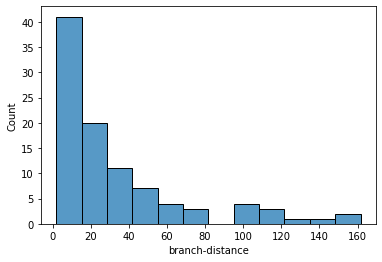

In [ ]:
print(datasets_NR[0].head())
print("approximation branch equals")
sns.histplot(data=datasets_NR[0],x="branch-distance")

#### Histogram Database Creation

In [ ]:
datasets_hist_NR =[]
for set in range(0,NO_ROP_Segments.shape[0]):
  datasets_set = []
  index_0 = 0
  for len,index_old in zip(list(map(int, datasets_NR[set]["branch-distance"])),list(datasets_NR[set].index)):
    for index_new in range(len):
      if (index_old==0)and(index_new==0):
        datasets_set = datasets_NR[set].loc[0:1,:]
      else:
        if (index_old==0)and(index_new==1):
          datasets_set.loc[index_new,:] = datasets_NR[set].loc[index_old,:]
        else:
          datasets_set = datasets_set.append(datasets_NR[set].loc[index_old,:],ignore_index=True)
  datasets_hist_NR.append(datasets_set)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1758: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, v)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


   skeleton-id  branch-distance  tortuosity  ...  centroid_y  image id   ROP
0            1       142.441125    1.074293  ...  195.357349         1  b'F'
1            1       142.441125    1.074293  ...  195.357349         1  b'F'
2            1       142.441125    1.074293  ...  195.357349         1  b'F'
3            1       142.441125    1.074293  ...  195.357349         1  b'F'
4            1       142.441125    1.074293  ...  195.357349         1  b'F'

[5 rows x 8 columns]


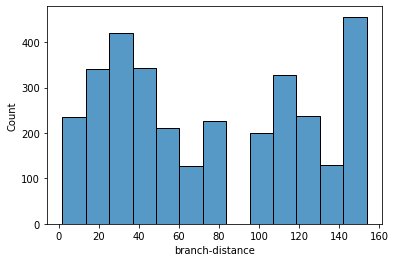

In [ ]:
print(datasets_hist_NR[0].head())
sns.histplot(data=datasets_hist_NR[0],x="branch-distance")

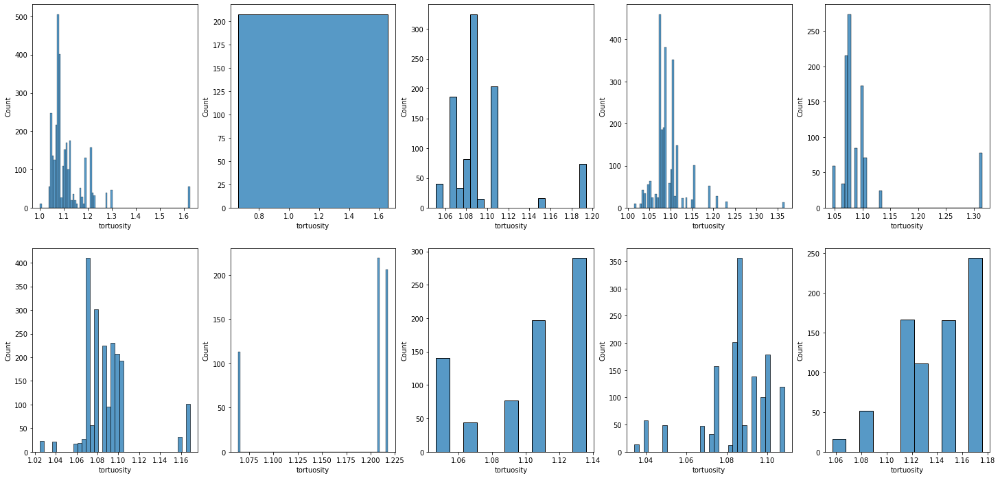

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_NR[num][datasets_hist_NR[num]["branch-distance"]>10],x="tortuosity",ax=ax[x, y])
    num = num+1

,skeleton-id,branch-distance,tortuosity,thickness,centroid_x,centroid_y,image id,ROP


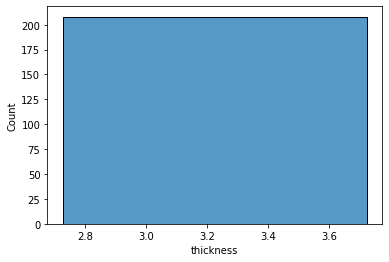

In [ ]:
sns.histplot(data=datasets_hist_NR[2],x="thickness")
datasets_NR[2][datasets_NR[2]["thickness"]>18]

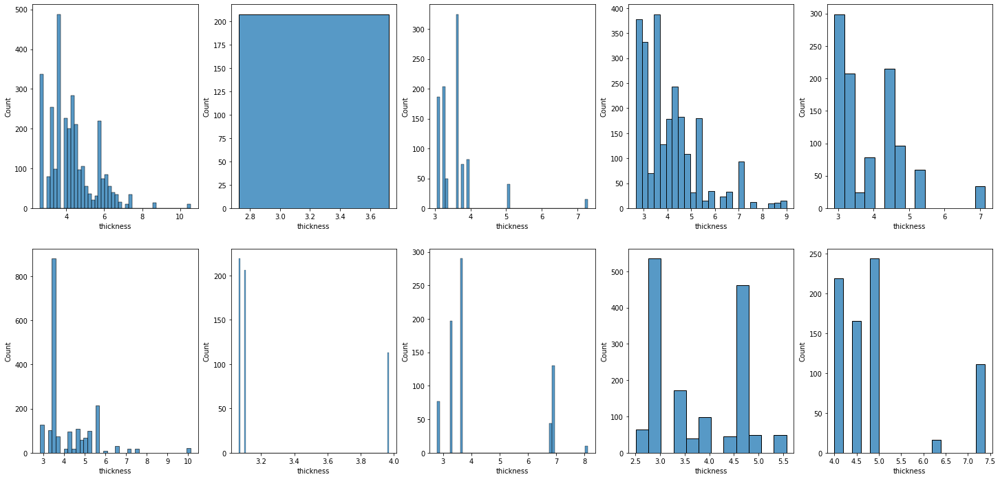

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_NR[num][datasets_hist_NR[num]["branch-distance"]>10],x="thickness",ax=ax[x, y])
    num = num+1

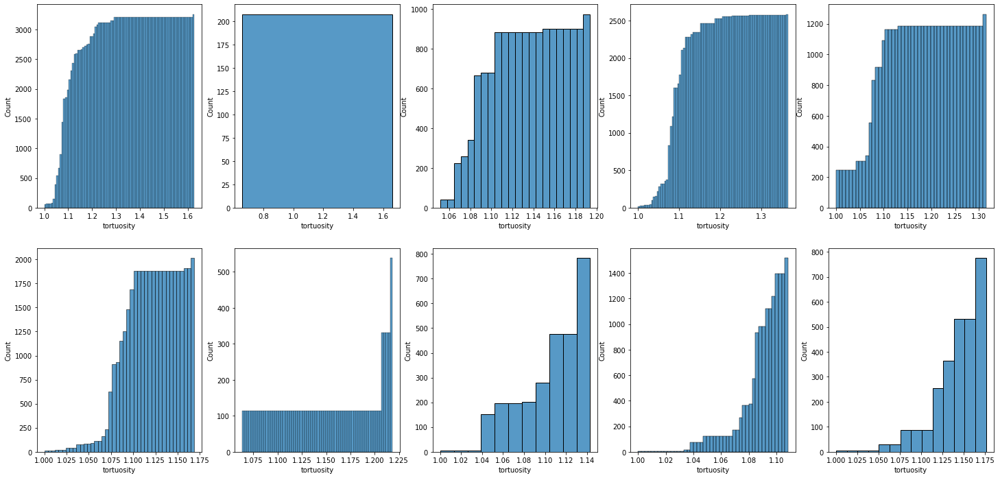

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_NR[num],x="tortuosity",cumulative=True,ax=ax[x, y])
    num = num+1

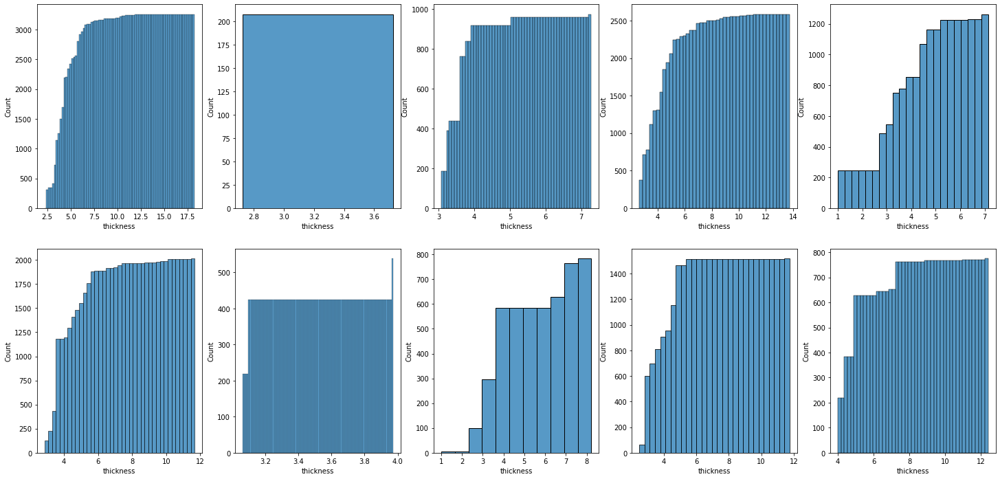

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_NR[num],x="thickness",cumulative=True,ax=ax[x, y])
    num = num+1

In [ ]:
Tortuosity_mean_NR = np.zeros((20))
Thickness_mean_NR = np.zeros((20))
for i in range(20):
  Tortuosity_mean_NR[i] = np.mean(list(datasets_hist_NR[i][datasets_hist_NR[i]["branch-distance"]>10]["tortuosity"]))
  Thickness_mean_NR[i] = np.mean(list(datasets_hist_NR[i][datasets_hist_NR[i]["branch-distance"]>10]["thickness"]))

print("NO-ROP CASES")
print("Tortuosities : ",list(Tortuosity_mean_NR))
print("Mean         : ",np.mean(list(Tortuosity_mean_NR)))
print("Thickness    : ",list(Thickness_mean_NR))
print("Mean         : ",np.mean(list(Thickness_mean_NR)))

NO-ROP CASES
Tortuosities :  [1.115479941933748, 1.0892445634767098, 1.1596634662613208, 1.1818373477821296, 1.094964814028611, 1.1040535431498861, 1.0949807718248652, 1.085152134757323, 1.100403617523701, 1.140039618457507, 1.1227961585661914, 1.0935761616779986, 1.100970301549602, 1.0809047238904734, 1.0976012609896457, 1.1004163047293574, 1.1313124233961216, 1.1628600196256333, 1.2828862407433839, 1.2903581496826164]
Mean         :  1.1314750782023413
Thickness    :  [4.298129345790642, 4.211987549850763, 3.225274725274725, 3.2683271196742885, 3.566314013888556, 4.290477430872116, 4.117277867733394, 3.7950848427394743, 3.881965368109613, 4.977498136050208, 5.03220871618091, 3.406232219591892, 4.571602823627115, 4.736363636363635, 4.3911969495376875, 4.6487970654637305, 3.228571428571428, 4.422363248075413, 4.446564587948528, 5.557784772248983]
Mean         :  4.203701092379655


### ROP Cases

#### Basic Datasets Creation

In [ ]:
import seaborn as sns
datasets_R = []
datasets_R_tot = []
for i in range(0,ROP_Segments.shape[0]):
  print("imagine : ",i+1)
  dataset = skeleton_description(ROP_Segments[i,:,:],False,i+1,"T")
  datasets_R.append(dataset)
  if (i==0):
    datasets_R_tot = dataset
  else:
    datasets_R_tot = datasets_R_tot.append(dataset)

imagine :  1
id :  [1, 2, 3, 4, 5]
skeleton id  1  regions : [0, 1, 2, 3, 4, 5, 8, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 112, 113, 114, 115, 116, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 

#### Histogram Database Creation

In [ ]:
datasets_hist_R =[]
for set in range(0,ROP_Segments.shape[0]):
  datasets_set = []
  index_0 = 0
  for len,index_old in zip(list(map(int, datasets_R[set]["branch-distance"])),list(datasets_R[set].index)):
    for index_new in range(len):
      if (index_old==0)and(index_new==0):
        datasets_set = datasets_R[set].loc[0:1,:]
      else:
        if (index_old==0)and(index_new==1):
          datasets_set.loc[index_new,:] = datasets_R[set].loc[index_old,:]
        else:
          datasets_set = datasets_set.append(datasets_R[set].loc[index_old,:],ignore_index=True)
  datasets_hist_R.append(datasets_set)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1758: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, v)


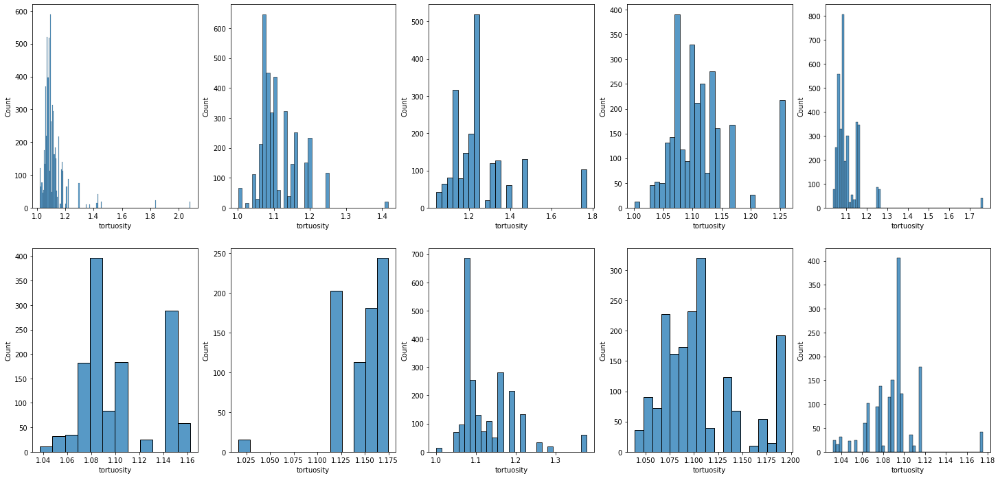

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_R[num][datasets_hist_R[num]["branch-distance"]>10],x="tortuosity",ax=ax[x, y])
    num = num+1

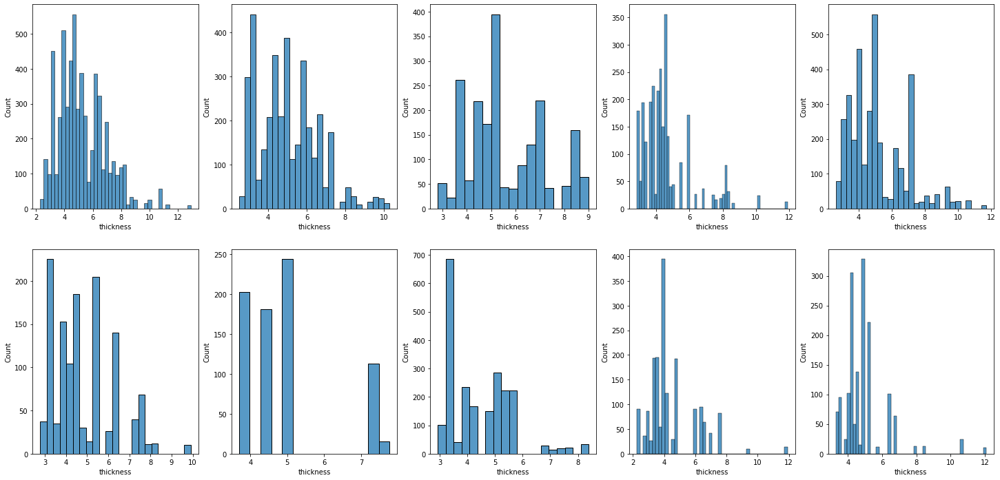

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_R[num][datasets_hist_R[num]["branch-distance"]>10],x="thickness",ax=ax[x, y])
    num = num+1

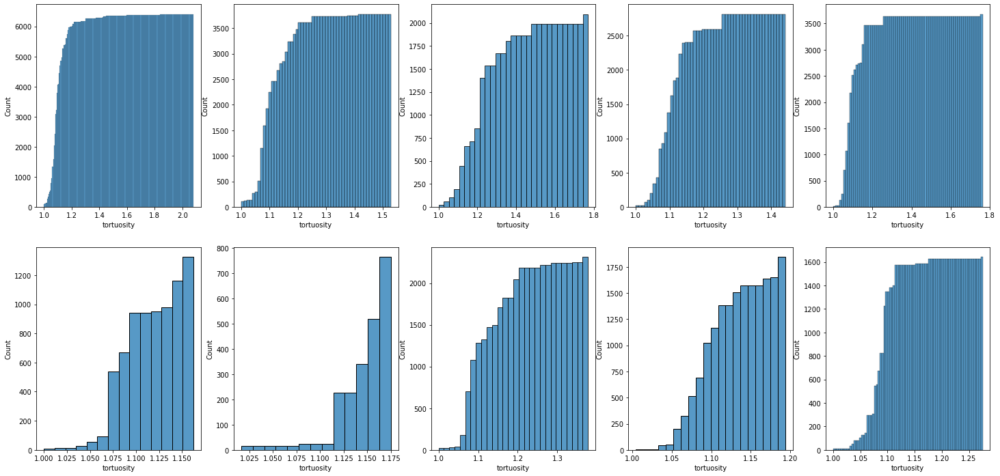

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_R[num],x="tortuosity",cumulative=True,ax=ax[x, y])
    num = num+1

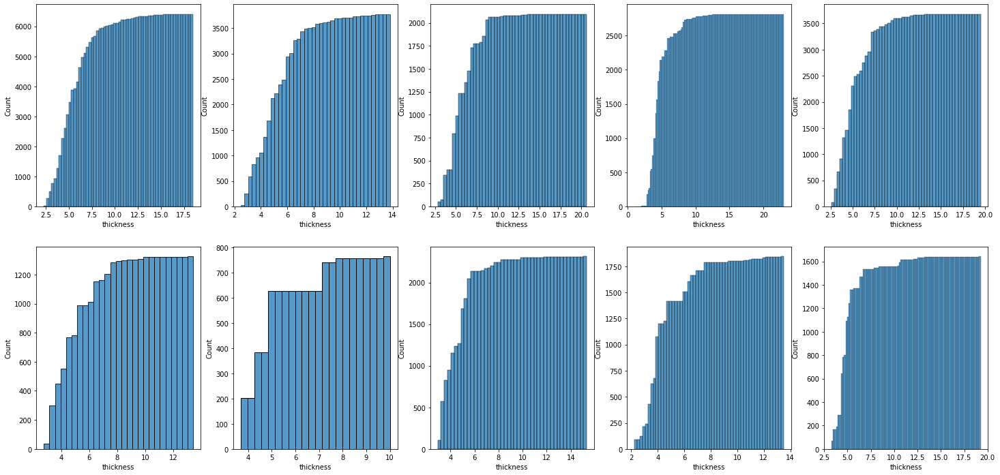

In [ ]:
fig, ax = plt.subplots(2,5,figsize=(25,12))
num = 0
for y in range(5):
  for x in range(2):
    sns.histplot(data=datasets_hist_R[num],x="thickness",cumulative=True,ax=ax[x, y])
    num = num+1

In [ ]:
Tortuosity_mean_R = np.zeros((20))
Thickness_mean_R = np.zeros((20))
for i in range(20):
  Tortuosity_mean_R[i] = np.mean(list(datasets_hist_R[i][datasets_hist_R[i]["branch-distance"]>10]["tortuosity"]))
  Thickness_mean_R[i] = np.mean(list(datasets_hist_R[i][datasets_hist_R[i]["branch-distance"]>10]["thickness"]))

print("ROP CASES")
print("Tortuosities : ",list(Tortuosity_mean_R))
print("Mean         : ",np.mean(list(Tortuosity_mean_R)))
print("Thickness    : ",list(Thickness_mean_R))
print("Mean         : ",np.mean(list(Thickness_mean_R)))

ROP CASES
Tortuosities :  [1.112573763097071, 1.1024463316581927, 1.11365480359271, 1.148228785612091, 1.25612122607325, 1.1269340112824688, 1.113259230189829, 1.1074887463815029, 1.1119225493517144, 1.089067841984787, 1.152832889361593, 1.135136998039716, 1.1223817333610269, 1.1541935012395863, 1.130479439424983, 1.120162711365895, 1.1438231128327332, 1.1425027925090077, 1.1115102505403842, 1.2525887919888468]
Mean         :  1.1373654754943694
Thickness    :  [5.242431653985097, 4.878457470715763, 5.019828348082012, 4.908450639271921, 5.643639136794964, 4.468174820970548, 4.598814096015838, 4.427117591281089, 5.104996967158608, 4.928762473005186, 4.445546424008616, 4.705602650946324, 6.238625469763112, 4.638732638265507, 5.553317385758443, 5.3659723058045445, 4.581063543287121, 4.368733413565463, 4.7556541758014825, 5.309726848846106]
Mean         :  4.959182402666387


### White Addition

In [ ]:
I1 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/1_test.jpg")                                           
I2 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/2_test.jpg")                                           
I3 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/3_test.jpg")                                           
I4 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/4_test.jpg")                                           
I5 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/5_test.jpg")                                           
I6 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/6_test.jpg")                                           
I7 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/7_test.jpg")                                           
I8 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/8_test.jpg")                                           
I9 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/9_test.jpg")                                           
I10 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/10_test.jpg")                                                                               

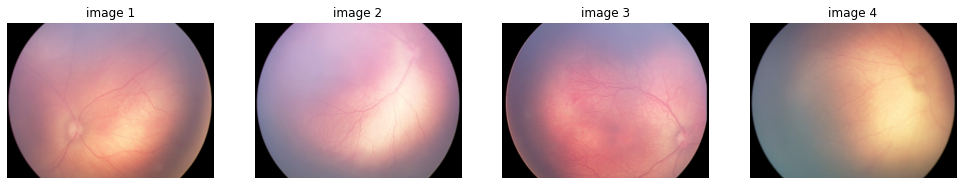

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(141,I2,'image 1')
imgG(142,I5,'image 2')
imgG(143,I1,'image 3')
imgG(144,I9,'image 4')

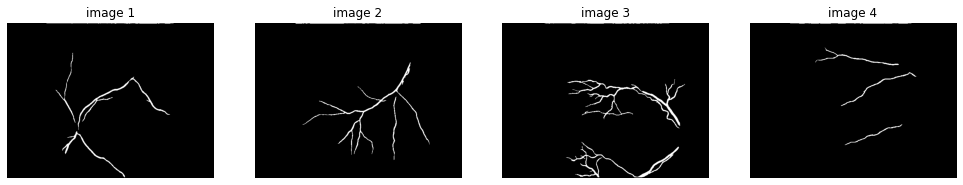

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(141,ROP_Segments[0],'image 1')
imgG(142,ROP_Segments[4],'image 2')
imgG(143,ROP_Segments[6],'image 3')
imgG(144,ROP_Segments[8],'image 4')

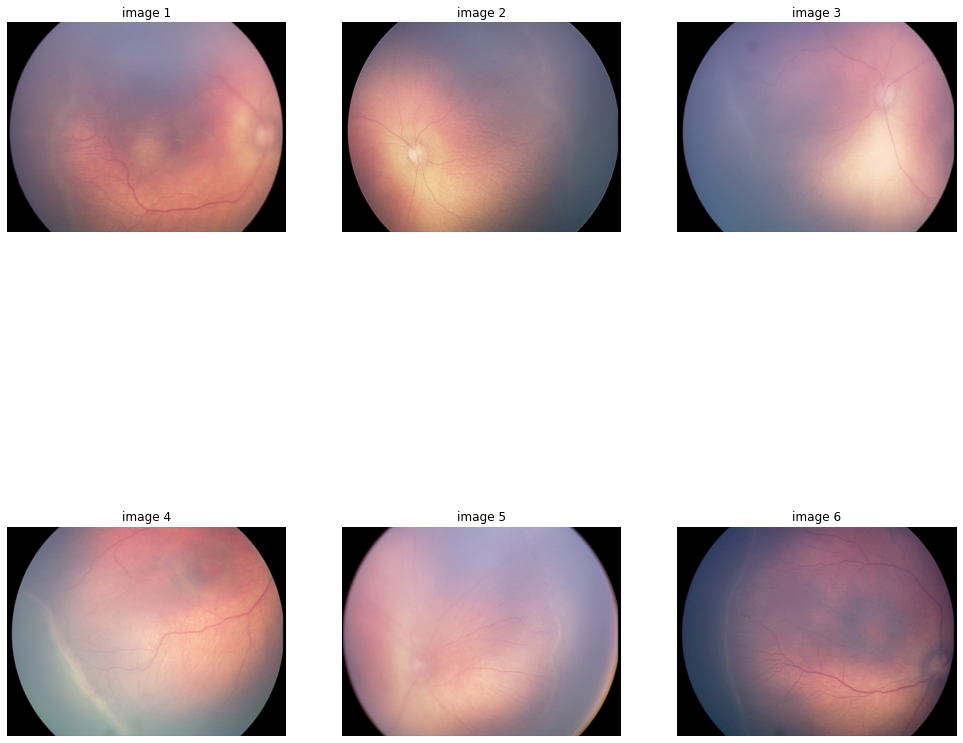

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(231,I3,'image 1')
imgG(232,I4,'image 2')
imgG(233,I6,'image 3')
imgG(234,I7,'image 4')
imgG(235,I8,'image 5')
imgG(236,I10,'image 6')

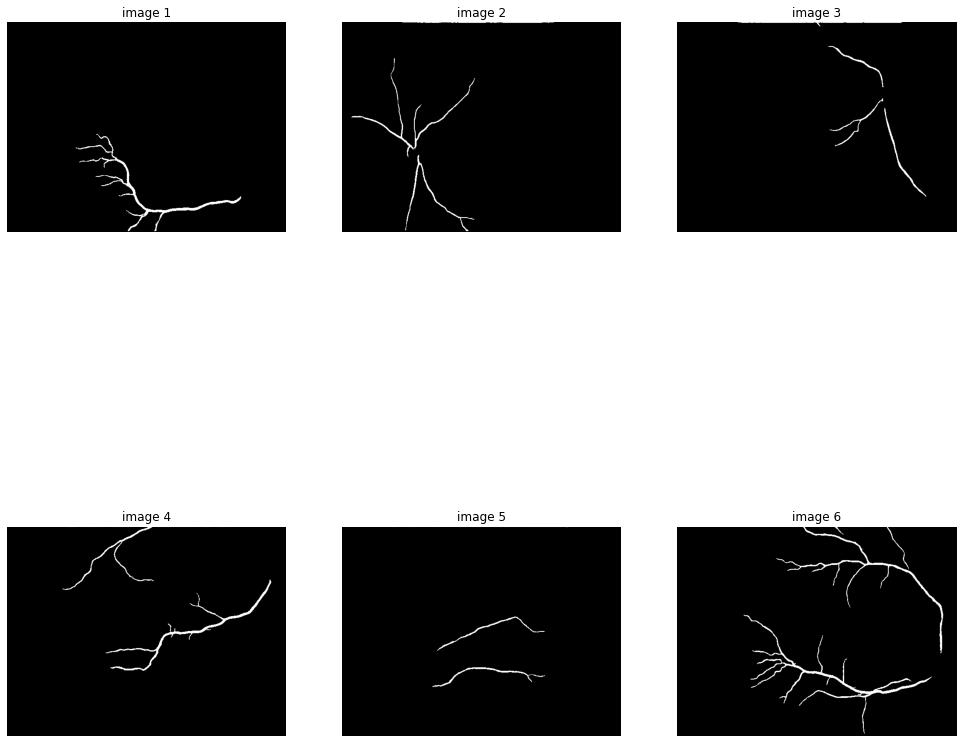

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(231,ROP_Segments[5],'image 1')
imgG(232,ROP_Segments[1],'image 2')
imgG(233,ROP_Segments[7],'image 3')
imgG(234,ROP_Segments[2],'image 4')
imgG(235,ROP_Segments[3],'image 5')
imgG(236,ROP_Segments[9],'image 6')

In [ ]:
ROP_Segments.shape
C_W = 0
C_NW = 0
ROP_W_Segments = np.zeros([4,ROP_Segments[0].shape[0],ROP_Segments[0].shape[1]])
ROP_NW_Segments = np.zeros([6,ROP_Segments[0].shape[0],ROP_Segments[0].shape[1]])
for i in (0,4,6,8):
  ROP_W_Segments[C_W] = ROP_Segments[i]
  C_W = C_W +1
for i in (5,1,7,2,3,9):
  ROP_NW_Segments[C_NW] = ROP_Segments[i]
  C_NW = C_NW +1

In [ ]:
datasets_R_W = []
datasets_R_W_tot = []
for i in range(0,ROP_W_Segments.shape[0]):
  print("imagine : ",i+1)
  dataset = skeleton_description(ROP_W_Segments[i,:,:],False,i+1,"W")
  datasets_R_W.append(dataset)
  if (i==0):
    datasets_R_W_tot = dataset
  else:
    datasets_R_W_tot = datasets_R_W_tot.append(dataset)

datasets_R_NW = []
datasets_R_NW_tot = []
for i in range(0,ROP_NW_Segments.shape[0]):
  print("imagine : ",i+1)
  dataset = skeleton_description(ROP_NW_Segments[i,:,:],False,i+1,"T")
  datasets_R_NW.append(dataset)
  if (i==0):
    datasets_R_NW_tot = dataset
  else:
    datasets_R_NW_tot = datasets_R_NW_tot.append(dataset)

imagine :  1
id :  [1, 2, 3, 4]
skeleton id  1  regions : [0]
skeleton id  2  regions : [1, 8, 9]
skeleton id  3  regions : [2, 3, 4, 5, 6, 7, 10, 11]
skeleton id  4  regions : [12, 13, 14, 15, 16, 17, 18, 19, 20, 21]
imagine :  2
id :  [1, 2, 20]
skeleton id  1  regions : [0]
skeleton id  2  regions : [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27]
skeleton id  20  regions : [28]
imagine :  3
id :  [1, 2, 3]
skeleton id  1  regions : [0]
skeleton id  2  regions : [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42]
skeleton id  3  regions : [43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72]
loops removed :  [47]
imagine :  4
id :  [1, 2, 5, 6]
skeleton id  1  regions : [0]
skeleton id  2  regions : [1, 2, 3]
skeleton id  5  regions : [4]
skeleton id  6  region

In [ ]:
datasets_hist_R_W =[]
for set in range(0,ROP_W_Segments.shape[0]):
  datasets_set = []
  index_0 = 0
  for len,index_old in zip(list(map(int, datasets_R_W[set]["branch-distance"])),list(datasets_R_W[set].index)):
    for index_new in range(len):
      if (index_old==0)and(index_new==0):
        datasets_set = datasets_R_W[set].loc[0:1,:]
      else:
        if (index_old==0)and(index_new==1):
          datasets_set.loc[index_new,:] = datasets_R_W[set].loc[index_old,:]
        else:
          datasets_set = datasets_set.append(datasets_R_W[set].loc[index_old,:],ignore_index=True)
  datasets_hist_R_W.append(datasets_set)

datasets_hist_R_NW =[]
for set in range(0,ROP_NW_Segments.shape[0]):
  datasets_set = []
  index_0 = 0
  for len,index_old in zip(list(map(int, datasets_R_NW[set]["branch-distance"])),list(datasets_R_NW[set].index)):
    for index_new in range(len):
      if (index_old==0)and(index_new==0):
        datasets_set = datasets_R_NW[set].loc[0:1,:]
      else:
        if (index_old==0)and(index_new==1):
          datasets_set.loc[index_new,:] = datasets_R_NW[set].loc[index_old,:]
        else:
          datasets_set = datasets_set.append(datasets_R_NW[set].loc[index_old,:],ignore_index=True)
  datasets_hist_R_NW.append(datasets_set)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1758: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, v)


### Comparison

In [ ]:
datasets_TOT = datasets_NR_tot.copy()
datasets_TOT = datasets_TOT.append(datasets_R_tot)
print(datasets_NR_tot.shape)
print(datasets_R_tot.shape)
print(datasets_TOT.shape)

(763, 8)
(1401, 8)
(2164, 8)


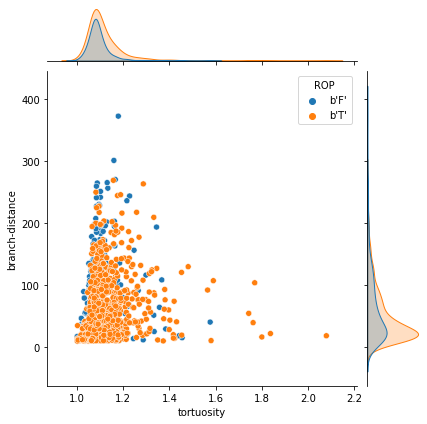

In [ ]:
sns.jointplot(data=datasets_TOT[datasets_TOT["branch-distance"]>10],x="tortuosity",y="branch-distance",hue="ROP")

In [ ]:
#1 dataset
datasets_TOT_PM = datasets_NR[6].copy()
datasets_TOT_PM=datasets_TOT_PM.append(datasets_R[5])
datasets_TOT_BM = datasets_NR[6].copy()
datasets_TOT_BM=datasets_TOT_BM.append(datasets_R[8])
datasets_TOT_CM = datasets_NR[3].copy()
datasets_TOT_CM=datasets_TOT_CM.append(datasets_R[1])

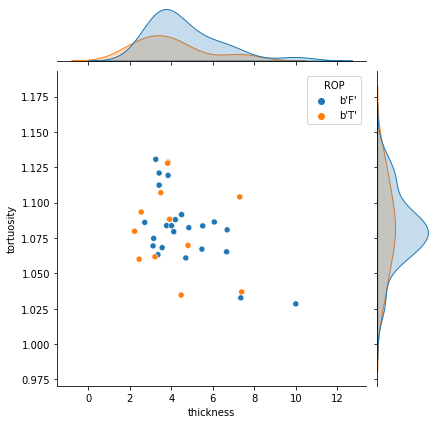

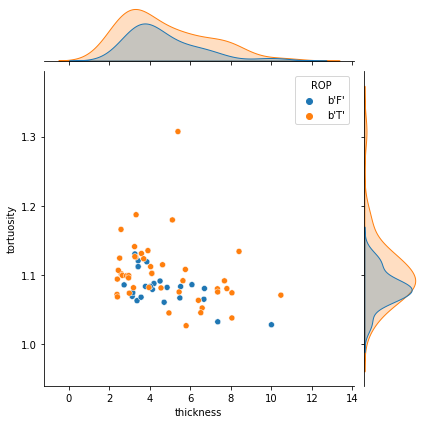

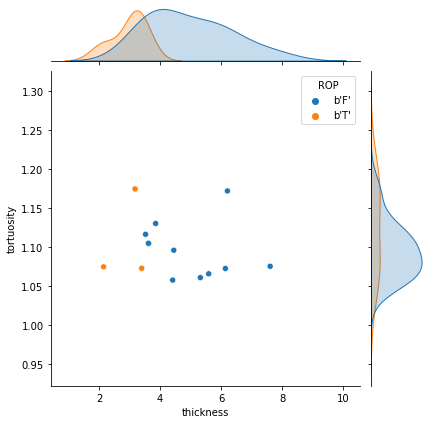

In [ ]:
#1 dataset
sns.jointplot(data=datasets_TOT_PM[datasets_TOT_PM["branch-distance"]>10],x="thickness",y="tortuosity",hue="ROP")
sns.jointplot(data=datasets_TOT_BM[datasets_TOT_BM["branch-distance"]>10],x="thickness",y="tortuosity",hue="ROP")
sns.jointplot(data=datasets_TOT_CM[datasets_TOT_CM["branch-distance"]>10],x="thickness",y="tortuosity",hue="ROP")

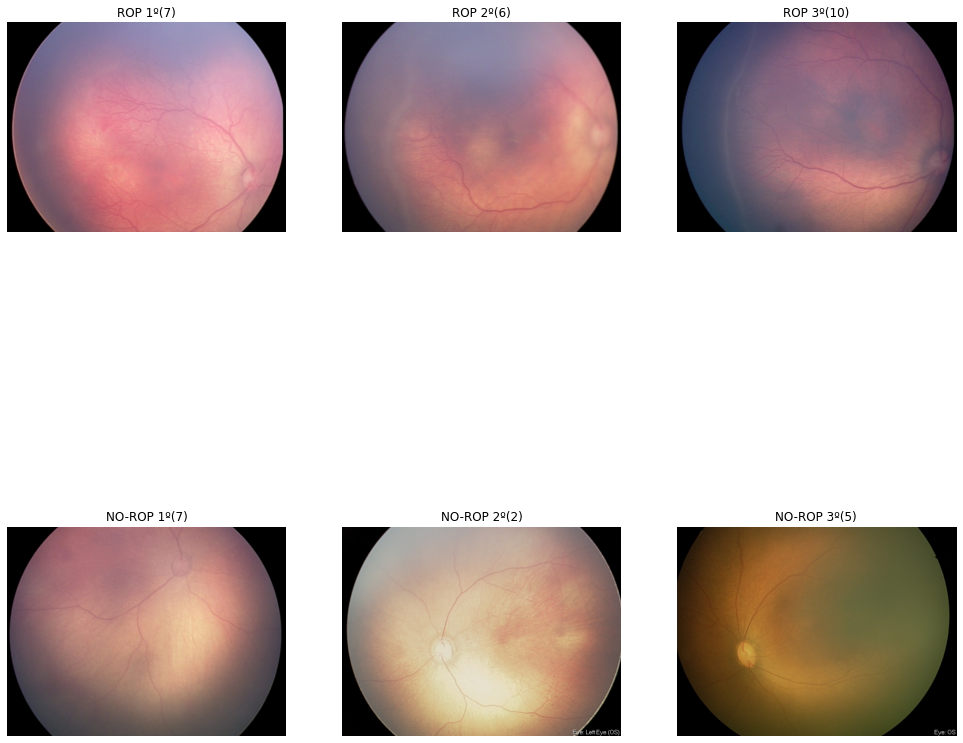

In [ ]:
ROP_1 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/1_test.jpg")
ROP_2 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/3_test.jpg")
ROP_3 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/test/images/10_test.jpg")
NO_ROP_1 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/6_test.jpg")
NO_ROP_2 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/1_test.jpg")
NO_ROP_3 = sk.io.imread("/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/4_test.jpg")
fig = plt.figure(figsize=(17,17))
imgG(231,ROP_1,'ROP 1º(7)')
imgG(232,ROP_2,'ROP 2º(6)')
imgG(233,ROP_3,'ROP 3º(10)')
imgG(234,NO_ROP_1,'NO-ROP 1º(7)')
imgG(235,NO_ROP_2,'NO-ROP 2º(2)')
imgG(236,NO_ROP_3,'NO-ROP 3º(5)')

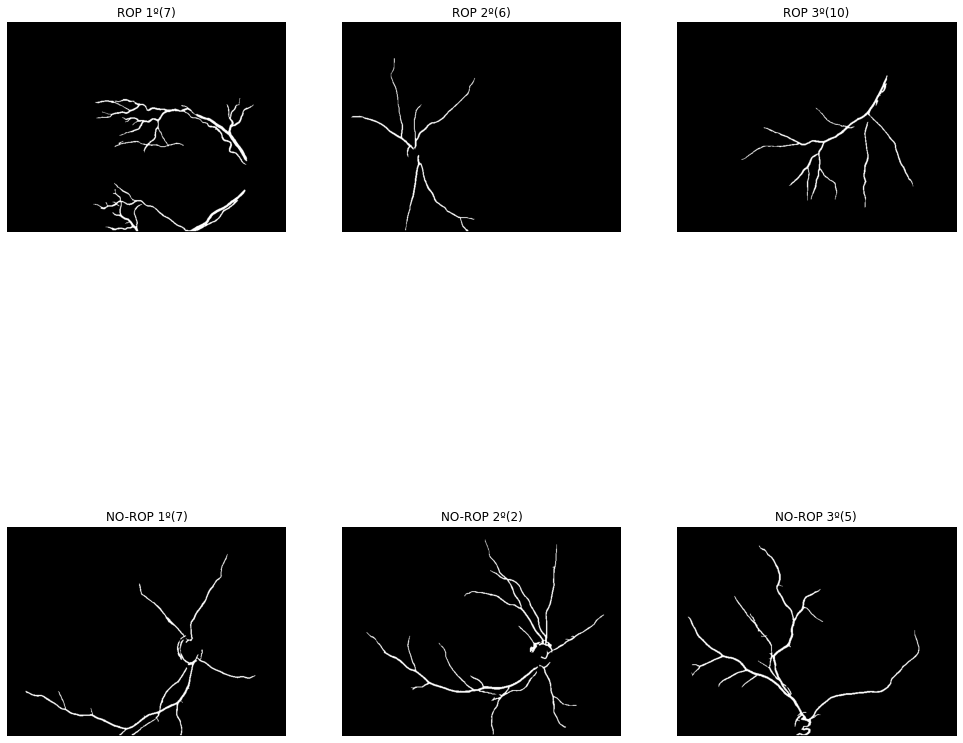

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(231,ROP_Segments[6],'ROP 1º(7)')
imgG(232,ROP_Segments[5],'ROP 2º(6)')
imgG(233,ROP_Segments[9],'ROP 3º(10)')
imgG(234,NO_ROP_Segments[6],'NO-ROP 1º(7)')
imgG(235,NO_ROP_Segments[1],'NO-ROP 2º(2)')
imgG(236,NO_ROP_Segments[4],'NO-ROP 3º(5)')

skeleton-id              2.000000
node-id-src            665.000000
node-id-dst           1411.000000
branch-distance          8.113887
branch-type              1.000000
mean-pixel-value         1.000000
stdev-pixel-value        0.000000
image-coord-src-0      390.666667
image-coord-src-1      247.666667
image-coord-dst-0      383.000000
image-coord-dst-1      247.000000
coord-src-0            390.666667
coord-src-1            247.666667
coord-dst-0            383.000000
coord-dst-1            247.000000
euclidean-distance       7.695598
Name: 42, dtype: float64
image    lenght        2175
image    tortuosity    1.11218564609973
image    thickness     3.6845977011494253
segment  lenght        507.9142135623731
segment  tortuosity    1.0543543424355146
segment  thickness     3.3333333333333335
skeleton-id              2.000000
node-id-src            665.000000
node-id-dst           1438.000000
branch-distance          4.699673
branch-type              1.000000
mean-pixel-value         1

(array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]), (390, 247))

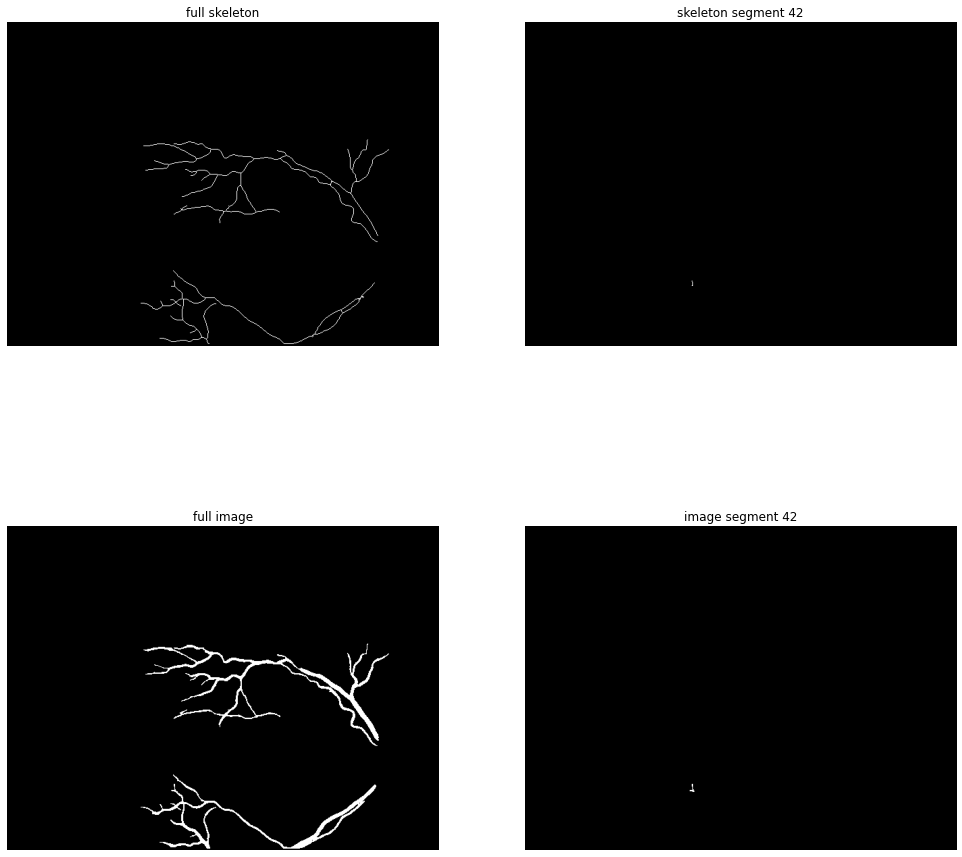

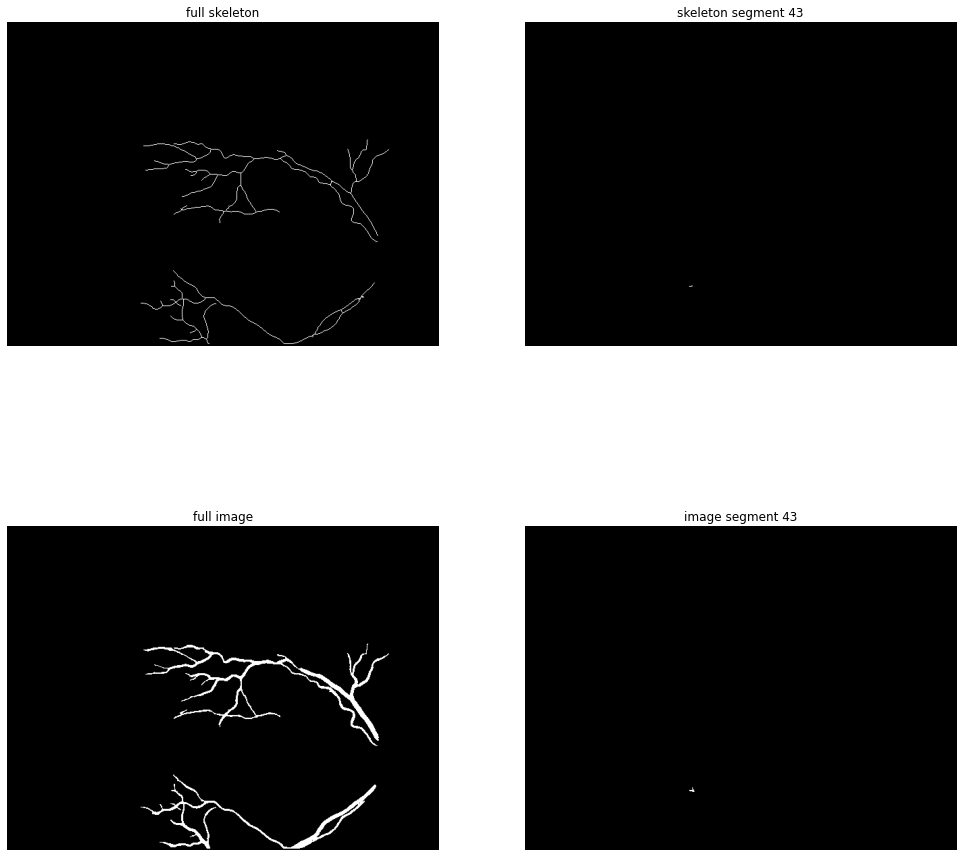

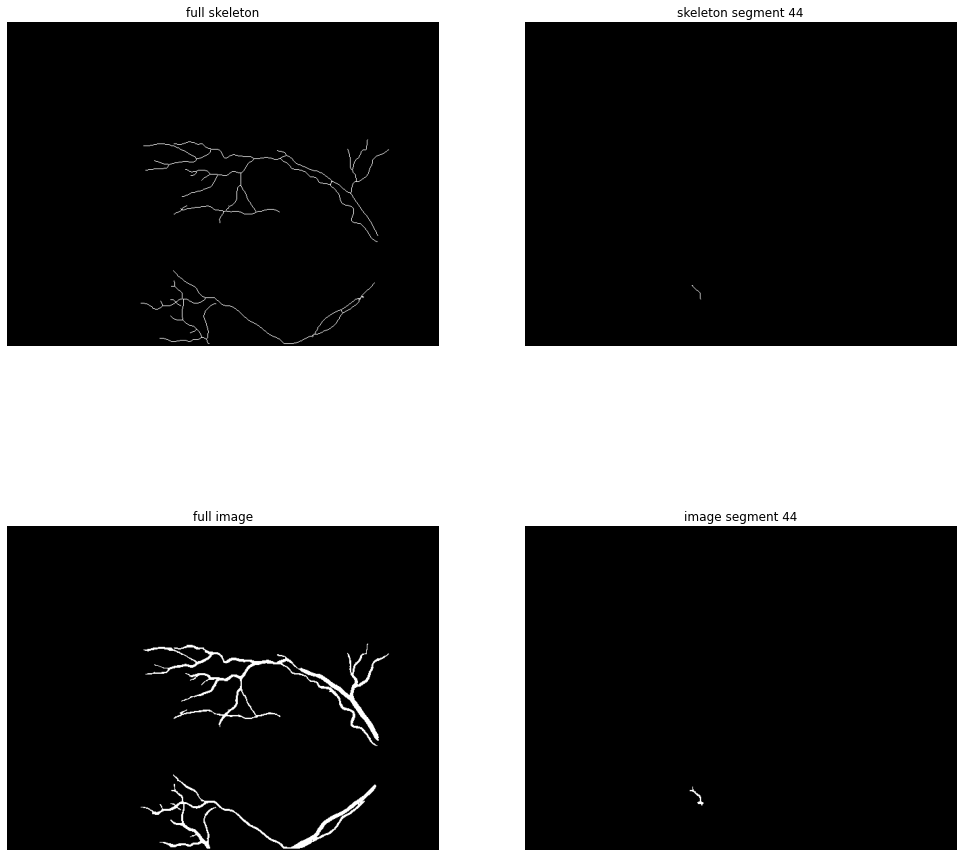

In [ ]:


region_description(ROP_Segments[6],42)
region_description(ROP_Segments[6],43)
region_description(ROP_Segments[6],44)

#datasets_R[6][datasets_R[6]["thickness"]>10000]

In [ ]:
datasets_TOT_Pool_R = datasets_R[6].copy()
datasets_TOT_Pool_R=datasets_TOT_Pool_R.append(datasets_R[5])
datasets_TOT_Pool_R=datasets_TOT_Pool_R.append(datasets_R[9])
datasets_TOT_Pool_NR=datasets_NR[6].copy()
datasets_TOT_Pool_NR=datasets_TOT_Pool_NR.append(datasets_NR[1])
datasets_TOT_Pool_NR=datasets_TOT_Pool_NR.append(datasets_NR[4])
datasets_TOT_Pool_TOT = datasets_TOT_Pool_R.copy()
datasets_TOT_Pool_TOT = datasets_TOT_Pool_TOT.append(datasets_TOT_Pool_NR)
sns.jointplot(data=datasets_TOT_Pool_R[datasets_TOT_Pool_R["branch-distance"]>10],x="thickness",y="tortuosity",hue="image id")
sns.jointplot(data=datasets_TOT_Pool_NR[datasets_TOT_Pool_NR["branch-distance"]>10],x="thickness",y="tortuosity",hue="image id")
sns.jointplot(data=datasets_TOT_Pool_TOT[datasets_TOT_Pool_TOT["branch-distance"]>10],x="thickness",y="tortuosity",hue="ROP")

In [ ]:
region_description(ROP_Segments[9],0)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import mixture

plt.figure(figsize=(12, 12))

n_samples = 1500
centers = [(0, 0), (5, 5)]
X_tot = datasets_TOT_Pool_TOT[datasets_TOT_Pool_TOT["branch-distance"]>10]
X = X_tot[["thickness","tortuosity"]].values
gmm = mixture.GaussianMixture(n_components=2,covariance_type='full')

plt.figure(figsize=(7,7))
labels = gmm.fit_predict(X)
plt.scatter(X[:, 0], X[:, 1], c=labels)
plt.title("GMM clustering")
plt.show()

#### White Addition

In [ ]:
datasets_TOT_W = datasets_NR_tot.copy()
datasets_TOT_W = datasets_TOT_W.append(datasets_R_W_tot)
datasets_TOT_W = datasets_TOT_W.append(datasets_R_NW_tot)
datasets_TOT_ROP = datasets_R_W_tot.copy()
datasets_TOT_ROP = datasets_TOT_ROP.append(datasets_R_NW_tot)

In [ ]:
sns.jointplot(data=datasets_TOT_ROP[datasets_TOT_ROP["branch-distance"]>10],x="tortuosity",y="thickness",hue="ROP")

In [ ]:
sns.jointplot(data=datasets_TOT_W[datasets_TOT_W["branch-distance"]>10],x="tortuosity",y="thickness",hue="ROP")

### White Boarder

In [ ]:
from skimage.color import rgb2gray
from skimage.filters import laplace, gaussian
from skimage import exposure, img_as_ubyte
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from skimage import exposure

In [ ]:
I1_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/10_test.jpg"
M1_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/mask/10_test_mask.gif"
P1_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/10_pred.jpg"
I2_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/7_test.jpg"
M2_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/mask/7_test_mask.gif"
P2_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/7_pred.jpg"
I3_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/4_test.jpg"
M3_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/mask/4_test_mask.gif"
P3_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/4_pred.jpg"

In [ ]:
gamma = 1.8
CL = 0.15

I1 = sk.io.imread(I1_Path)                                           #image
I2 = sk.io.imread(I2_Path)
I3 = sk.io.imread(I3_Path)
M3 = sk.io.imread(M3_Path)                                           #mask
M2 = sk.io.imread(M2_Path)
M1 = sk.io.imread(M1_Path)
P1 = sk.io.imread(P1_Path)                                           #prediction
P2 = sk.io.imread(P2_Path)
P3 = sk.io.imread(P3_Path)
I1_I = 255-I1                                                        #inverted colours
I2_I = 255-I2
I3_I = 255-I3
I1_G = exposure.adjust_gamma(I1, gamma)                              #gamma filter
I2_G = exposure.adjust_gamma(I2, gamma)
I3_G = exposure.adjust_gamma(I3, gamma)
I1_I_G = exposure.adjust_gamma(I1_I, gamma)                              
I2_I_G = exposure.adjust_gamma(I2_I, gamma)
I3_I_G = exposure.adjust_gamma(I3_I, gamma)
I1_A = exposure.equalize_adapthist(I1_G, clip_limit=CL)            #CLAHE filter
I2_A = exposure.equalize_adapthist(I2_G, clip_limit=CL)
I3_A = exposure.equalize_adapthist(I3_G, clip_limit=CL)
I1_I_A = exposure.equalize_adapthist(I1_I_G, clip_limit=CL)            
I2_I_A = exposure.equalize_adapthist(I2_I_G, clip_limit=CL)
I3_I_A = exposure.equalize_adapthist(I3_I_G, clip_limit=CL)


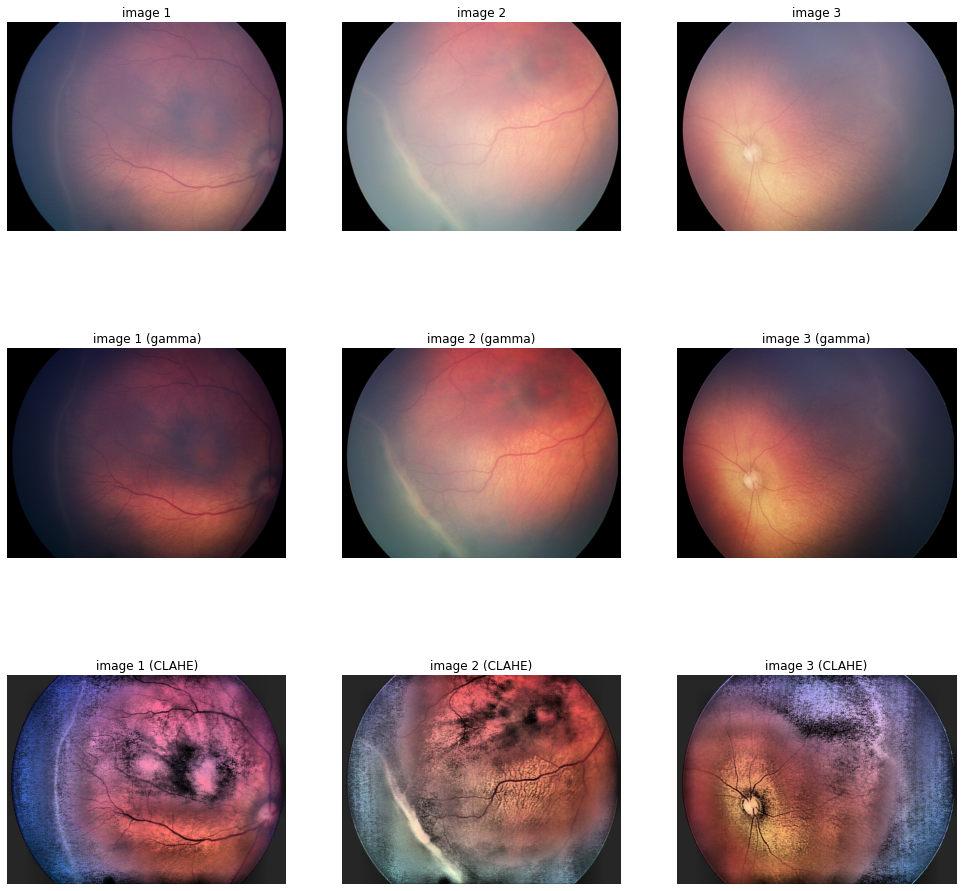

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(331,I1,'image 1')
imgG(332,I2,'image 2')
imgG(333,I3,'image 3')
imgG(334,I1_G,'image 1 (gamma)')
imgG(335,I2_G,'image 2 (gamma)')
imgG(336,I3_G,'image 3 (gamma)')
imgG(337,I1_A,'image 1 (CLAHE)')
imgG(338,I2_A,'image 2 (CLAHE)')
imgG(339,I3_A,'image 3 (CLAHE)')

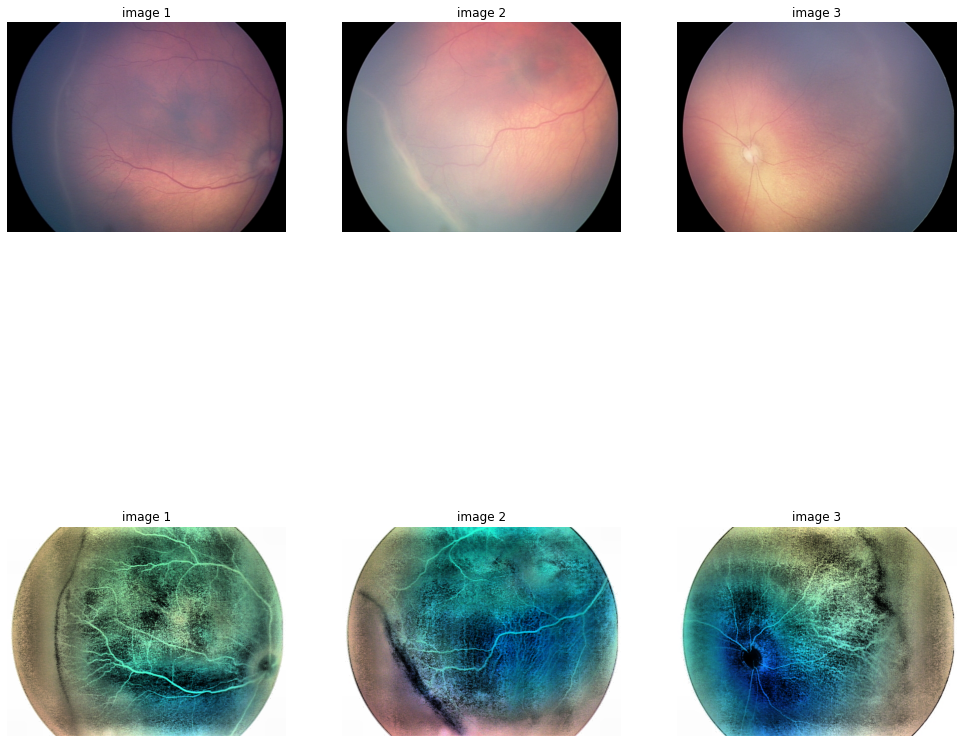

In [ ]:
from PIL import Image
import PIL.ImageOps   
from numpy import asarray 

fig = plt.figure(figsize=(17,17))
imgG(231,I1,'image 1')
imgG(232,I2,'image 2')
imgG(233,I3,'image 3')
imgG(234,I1_I_A,'image 1')
imgG(235,I2_I_A,'image 2')
imgG(236,I3_I_A,'image 3')



In [ ]:
min_x = -1
min_y = -1
max_x = -1
max_y = -1
for i in range(P1.shape[0]):
  for j in range (P1.shape[1]):
    if (P1[i,j]>1):
      if (min_x==-1):
        min_x = i
        max_x = i
        min_y = j
        max_y = j
      if (min_x>i):
        min_x = i
      if (max_x<i):
        max_x = i
      if (min_y>j):
        min_y = j
      if (max_y<j):
        max_y = j

I1_BG = I1.copy()
I1_BG_A = I1_A.copy()
I1_BG_I = I1_I_A.copy()
for i in range(min_x,max_x):
  for j in range (min_y,max_y):
    I1_BG[i,j] = 0
    I1_BG_A[i,j] = 0
    I1_BG_I[i,j] = 1

In [ ]:
min_x = -1
min_y = -1
max_x = -1
max_y = -1
for i in range(P2.shape[0]):
  for j in range (P2.shape[1]):
    if (P2[i,j]>1):
      if (min_x==-1):
        min_x = i
        max_x = i
        min_y = j
        max_y = j
      if (min_x>i):
        min_x = i
      if (max_x<i):
        max_x = i
      if (min_y>j):
        min_y = j
      if (max_y<j):
        max_y = j

I2_BG = I2.copy()
I2_BG_A = I2_A.copy()
I2_BG_I = I2_I_A.copy()
for i in range(min_x,max_x):
  for j in range (min_y,max_y):
    I2_BG[i,j]=0
    I2_BG_A[i,j]=0
    I2_BG_I[i,j]=1

In [ ]:
min_x = -1
min_y = -1
max_x = -1
max_y = -1
for i in range(P3.shape[0]):
  for j in range (P3.shape[1]):
    if (P3[i,j]>1):
      if (min_x==-1):
        min_x = i
        max_x = i
        min_y = j
        max_y = j
      if (min_x>i):
        min_x = i
      if (max_x<i):
        max_x = i
      if (min_y>j):
        min_y = j
      if (max_y<j):
        max_y = j

I3_BG = I3.copy()
I3_BG_A = I3_A.copy()
I3_BG_I = I3_I_A.copy()
for i in range(min_x,max_x):
  for j in range (min_y,max_y):
    I3_BG[i,j]=0
    I3_BG_A[i,j]=0
    I3_BG_I[i,j]=1

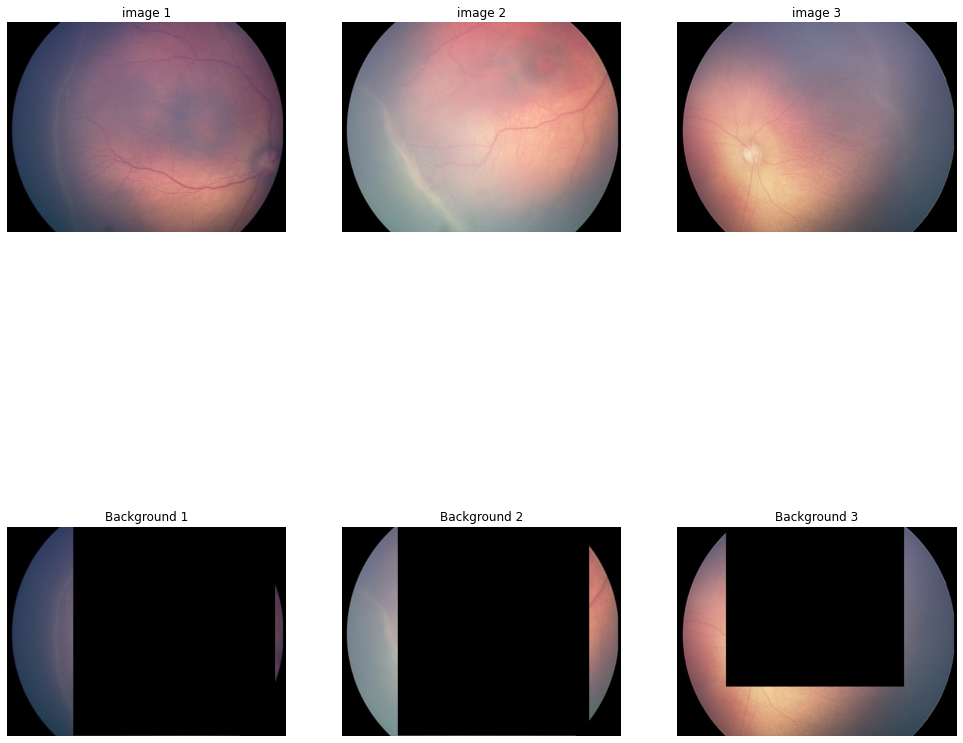

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(231,I1,'image 1')
imgG(232,I2,'image 2')
imgG(233,I3,'image 3')
imgG(234,I1_BG,'Background 1')
imgG(235,I2_BG,'Background 2')
imgG(236,I3_BG,'Background 3')

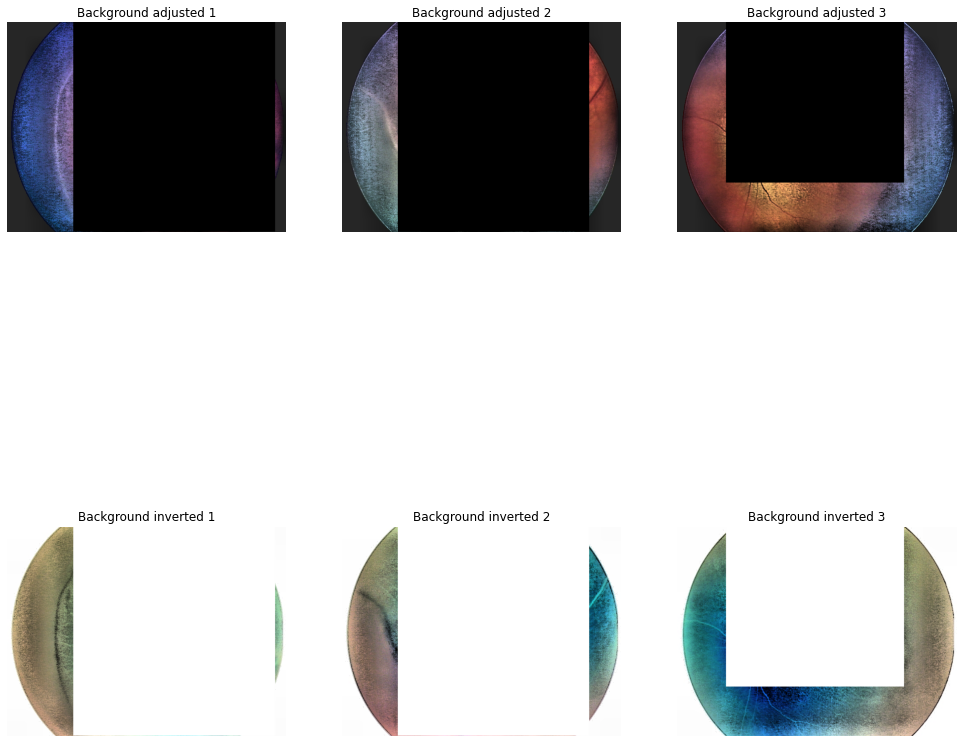

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(231,I1_BG_A,'Background adjusted 1')
imgG(232,I2_BG_A,'Background adjusted 2')
imgG(233,I3_BG_A,'Background adjusted 3')
imgG(234,I1_BG_I,'Background inverted 1')
imgG(235,I2_BG_I,'Background inverted 2')
imgG(236,I3_BG_I,'Background inverted 3')

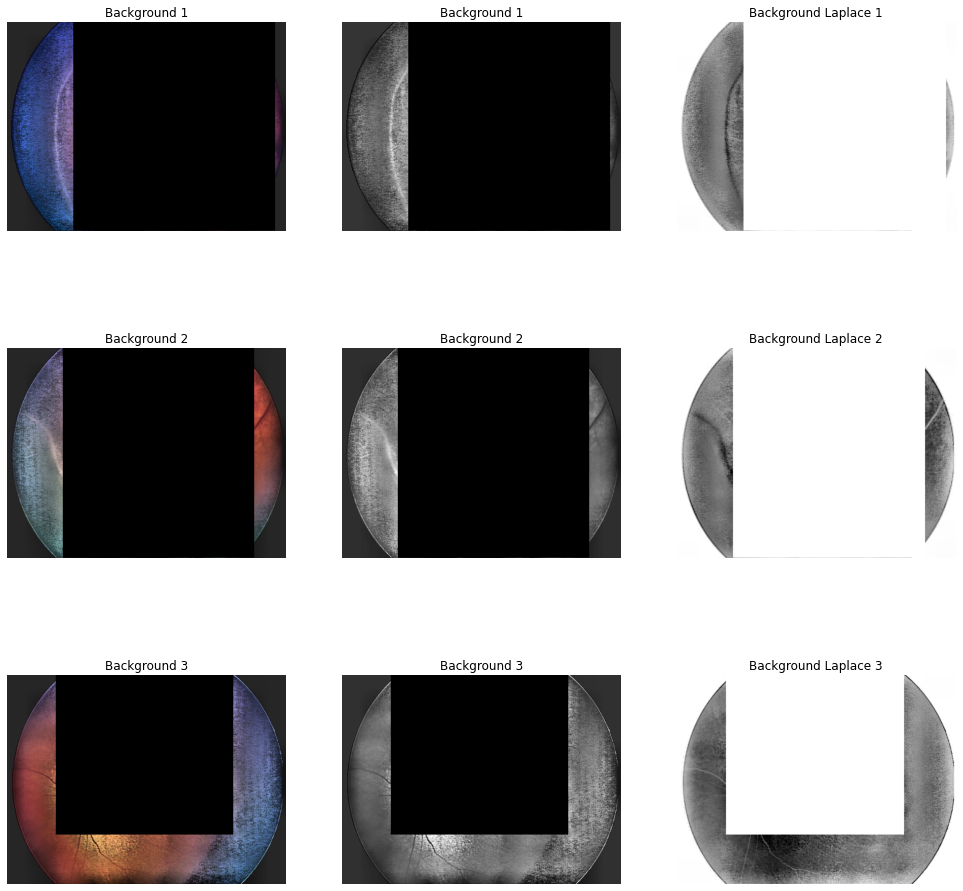

In [ ]:
I1_G = rgb2gray(I1_BG_A)
I1_I_G = rgb2gray(I1_BG_I)
I2_G = rgb2gray(I2_BG_A)
I2_I_G = rgb2gray(I2_BG_I)
I3_G = rgb2gray(I3_BG_A)
I3_I_G = rgb2gray(I3_BG_I)
fig = plt.figure(figsize=(17,17))
imgG(331,I1_BG_A,'Background 1')
imgG(332,I1_G,'Background 1')
imgG(333,I1_I_G,'Background Laplace 1')
imgG(334,I2_BG_A,'Background 2')
imgG(335,I2_G,'Background 2')
imgG(336,I2_I_G,'Background Laplace 2')
imgG(337,I3_BG_A,'Background 3')
imgG(338,I3_G,'Background 3')
imgG(339,I3_I_G,'Background Laplace 3')

0.5141669649620528

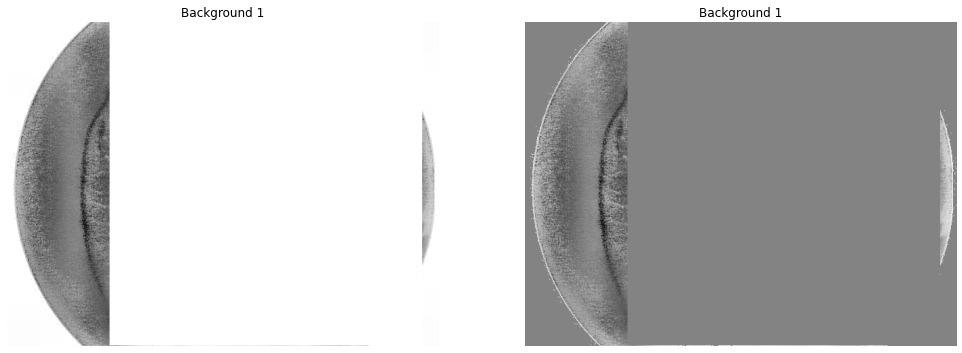

In [ ]:
I1_fin = I1_I_G.copy()
I1_fin[I1_fin>0.95] = np.mean(I1_fin[I1_fin<0.95])
fig = plt.figure(figsize=(17,17))
imgG(121,I1_I_G,'Background 1')
imgG(122,I1_fin,'Background 1')
np.mean(I1_fin[I1_fin<0.95])

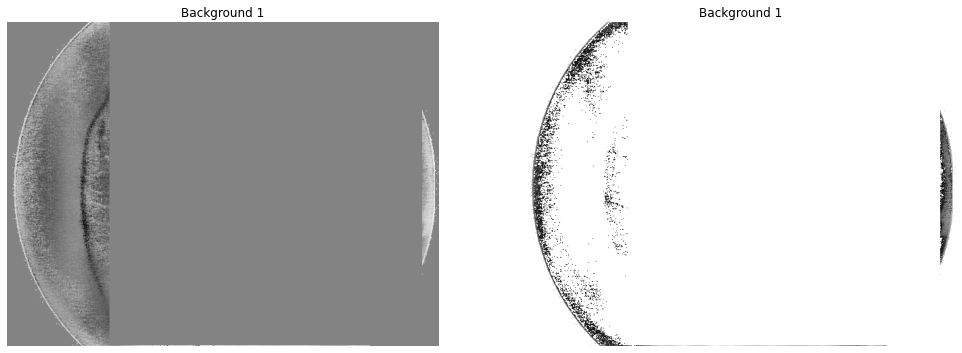

In [ ]:
I1_fin_w = I1_fin.copy()
I1_fin_w[I1_fin_w<0.6]=1
fig = plt.figure(figsize=(17,17))
imgG(121,I1_fin,'Background 1')
imgG(122,I1_fin_w,'Background 1')

In [ ]:
fig = make_subplots(rows=1, cols=3, shared_xaxes = 'all',shared_yaxes = 'all')
fig.add_trace(go.Image(z=I1), 1, 1)
fig.add_trace(go.Image(z=I1_BG), 1, 2)
fig.add_trace(go.Heatmap(z=I1_I_G*255), 1, 3)
fig.update_layout(height=1000, width=1000, title_text="Subplots with Shared Axes")
fig.show()

fig = make_subplots(rows=1, cols=3, shared_xaxes = 'all',shared_yaxes = 'all')
fig.add_trace(go.Image(z=I2), 1, 1)
fig.add_trace(go.Image(z=I2_BG), 1, 2)
fig.add_trace(go.Heatmap(z=I2_I_G*255), 1, 3)
fig.update_layout(height=1000, width=1000, title_text="Subplots with Shared Axes")
fig.show()

fig = make_subplots(rows=1, cols=3, shared_xaxes = 'all',shared_yaxes = 'all')
fig.add_trace(go.Image(z=I3), 1, 1)
fig.add_trace(go.Image(z=I3_BG), 1, 2)
fig.add_trace(go.Heatmap(z=I3_I_G*255), 1, 3)
fig.update_layout(height=1000, width=1000, title_text="Subplots with Shared Axes")
fig.show()

In [ ]:
I1_L = laplace(I1_G)


#### SELECTION

NameError: ignored

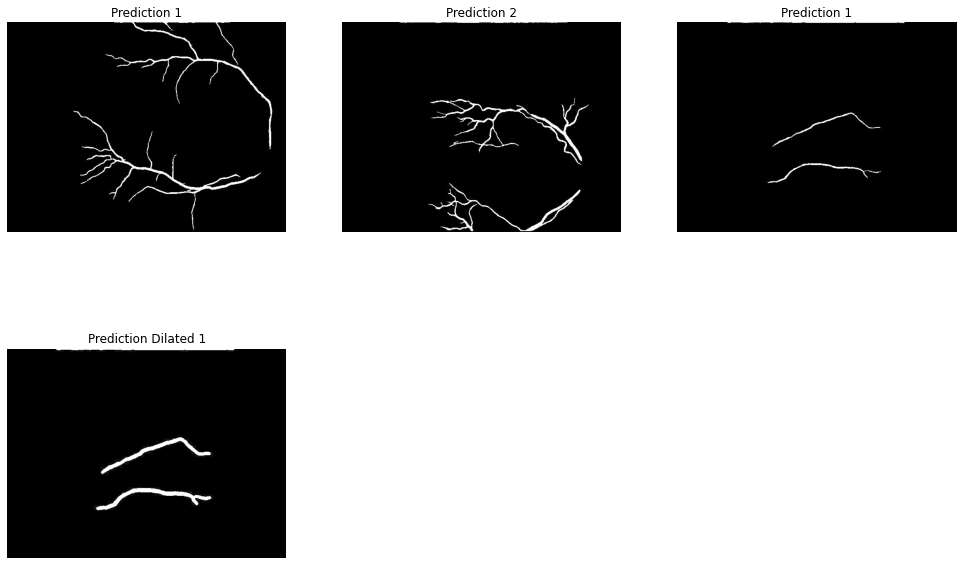

In [ ]:
from skimage.morphology import erosion, dilation
selem = disk(3)
P1_D = dilation(P1, selem)
P1_D = dilation(P2, selem)
P1_D = dilation(P3, selem)
fig = plt.figure(figsize=(17,17))
imgG(331,P1,'Prediction 1')
imgG(332,P2,'Prediction 2')
imgG(333,P3,'Prediction 1')
imgG(334,P1_D,'Prediction Dilated 1')
imgG(335,P2_D,'Prediction Dilated 2')
imgG(336,P3_D,'Prediction Dilated 3')

In [ ]:
ssr = skel_segment[280:300,200:220].copy()
ssr_E = np.zeros((ssr.shape[0],ssr.shape[1]))
ssr_I = np.zeros((ssr.shape[0],ssr.shape[1]))
pixel_graph_ssr0, coordinates_ssr0, degrees_ssr0 = skeleton_to_csgraph(ssr)
for i in (1,2,3):
  pixel_graph_ssr, coordinates_ssr, degrees_ssr = skeleton_to_csgraph(ssr)
  ssr_E[degrees_ssr==1]=1
  ssr[degrees_ssr==1]=0
ssr_I[ssr==1]=1
branch_data_ssr = summarize(Skeleton(ssr_E))
ssr_E12 = np.zeros((2,ssr.shape[0],ssr.shape[1]))
costs = np.where(ssr, 1, 1000)
vet_P = np.zeros((2,2,2))
slope = np.zeros((2))
for i in (0,1):
  start = (int(branch_data_ssr.loc[i]["coord-src-0"]),int(branch_data_ssr.loc[i]["coord-src-1"]))
  end = (int(branch_data_ssr.loc[i]["coord-dst-0"]),int(branch_data_ssr.loc[i]["coord-dst-1"]))
  vet_P[i,0,:] = start
  vet_P[i,1,0] = start[0]+end[1]-start[1]
  vet_P[i,1,1] = start[1]-end[0]+start[0]
  slope[i] = (vet_P[i,1,1]-vet_P[i,0,1])/(vet_P[i,1,0]-vet_P[i,0,0])
  path, cost = skimage.graph.route_through_array(costs, start=start, end=end, fully_connected=True,geometric=True)
  for (x,y) in path:
    ssr_E12[i,x,y]=1
E0_o = np.logical_and(ssr_E12[0,:,:],degrees_ssr0==1)
E1_o = np.logical_and(ssr_E12[1,:,:],degrees_ssr0==1)


In [ ]:
selem = disk(3)
ssr_D = skel_segment[280:300,200:220].copy()
ssr_D = dilation(ssr_D, selem)

In [ ]:
E0_o = np.logical_and(ssr_E12[0,:,:],degrees_ssr0==1)
E1_o = np.logical_and(ssr_E12[1,:,:],degrees_ssr0==1)
E0_o==1

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(241,skel_segment[280:300,200:220],'full skeleton')
imgG(242,ssr_E12[0,:,:],'full skeleton')
imgG(243,ssr_E12[1,:,:],'full skeleton')
imgG(244,ssr_I,'full skeleton')
imgG(245,degrees_ssr0,'full skeleton')
imgG(246,E0_o,'full skeleton')
imgG(247,E1_o,'full skeleton')


In [ ]:
print(vet[0,:,:])
print(vet[1,:,:])

### Vein vs Arteries

In [ ]:
threshold_thick = 9
threshold_tort = 1.17

In [ ]:
VA_th_R1,VA_to_R1,VA_TT_R1 = VeinArteries(ROP_Segments[0],threshold_thick,threshold_tort)
VA_th_R2,VA_to_R2,VA_TT_R2 = VeinArteries(ROP_Segments[1],threshold_thick,threshold_tort)
VA_th_R3,VA_to_R3,VA_TT_R3 = VeinArteries(ROP_Segments[2],threshold_thick,threshold_tort)
VA_th_R4,VA_to_R4,VA_TT_R4 = VeinArteries(ROP_Segments[3],threshold_thick,threshold_tort)
VA_th_R5,VA_to_R5,VA_TT_R5 = VeinArteries(ROP_Segments[4],threshold_thick,threshold_tort)
VA_th_R6,VA_to_R6,VA_TT_R6 = VeinArteries(ROP_Segments[5],threshold_thick,threshold_tort)
VA_th_R7,VA_to_R7,VA_TT_R7 = VeinArteries(ROP_Segments[6],threshold_thick,threshold_tort)
VA_th_R8,VA_to_R8,VA_TT_R8 = VeinArteries(ROP_Segments[7],threshold_thick,threshold_tort)
VA_th_R9,VA_to_R9,VA_TT_R9 = VeinArteries(ROP_Segments[8],threshold_thick,threshold_tort)
VA_th_R10,VA_to_R10,VA_TT_R10 = VeinArteries(ROP_Segments[9],threshold_thick,threshold_tort)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:133: RuntimeWarning: divide by zero encountered in double_scalars


In [ ]:
VA_th_NR1,VA_to_NR1,VA_TT_NR1 = VeinArteries(NO_ROP_Segments[0],threshold_thick,threshold_tort)
VA_th_NR2,VA_to_NR2,VA_TT_NR2 = VeinArteries(NO_ROP_Segments[1],threshold_thick,threshold_tort)
VA_th_NR3,VA_to_NR3,VA_TT_NR3 = VeinArteries(NO_ROP_Segments[2],threshold_thick,threshold_tort)
VA_th_NR4,VA_to_NR4,VA_TT_NR4 = VeinArteries(NO_ROP_Segments[3],threshold_thick,threshold_tort)
VA_th_NR5,VA_to_NR5,VA_TT_NR5 = VeinArteries(NO_ROP_Segments[4],threshold_thick,threshold_tort)
VA_th_NR6,VA_to_NR6,VA_TT_NR6 = VeinArteries(NO_ROP_Segments[5],threshold_thick,threshold_tort)
VA_th_NR7,VA_to_NR7,VA_TT_NR7 = VeinArteries(NO_ROP_Segments[6],threshold_thick,threshold_tort)
VA_th_NR8,VA_to_NR8,VA_TT_NR8 = VeinArteries(NO_ROP_Segments[7],threshold_thick,threshold_tort)
VA_th_NR9,VA_to_NR9,VA_TT_NR9 = VeinArteries(NO_ROP_Segments[8],threshold_thick,threshold_tort)
VA_th_NR10,VA_to_NR10,VA_TT_NR10 = VeinArteries(NO_ROP_Segments[9],threshold_thick,threshold_tort)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:133: RuntimeWarning: divide by zero encountered in double_scalars


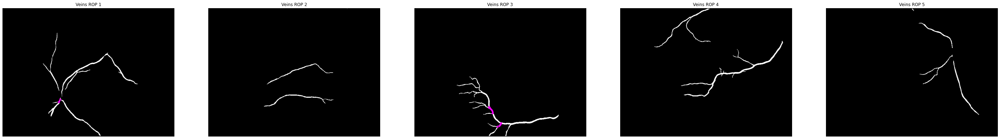

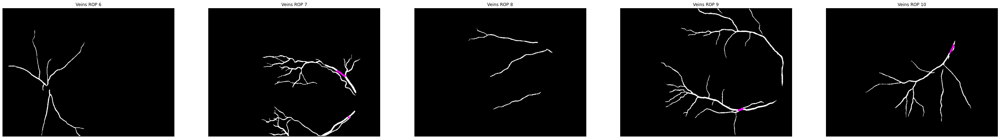

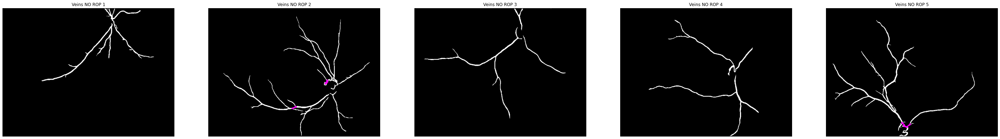

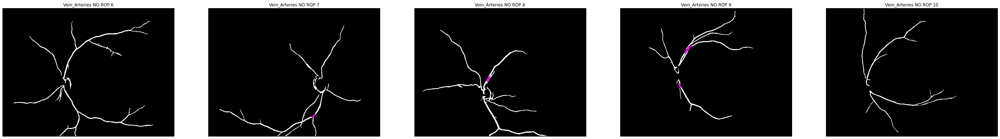

In [ ]:
fig = plt.figure(figsize=(50,50))
imgG(151,VA_th_R1,'Veins ROP 1')
imgG(152,VA_th_R2,'Veins ROP 2')
imgG(153,VA_th_R3,'Veins ROP 3')
imgG(154,VA_th_R4,'Veins ROP 4')
imgG(155,VA_th_R5,'Veins ROP 5')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_th_R6,'Veins ROP 6')
imgG(152,VA_th_R7,'Veins ROP 7')
imgG(153,VA_th_R8,'Veins ROP 8')
imgG(154,VA_th_R9,'Veins ROP 9')
imgG(155,VA_th_R10,'Veins ROP 10')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_th_NR1,'Veins NO ROP 1')
imgG(152,VA_th_NR2,'Veins NO ROP 2')
imgG(153,VA_th_NR3,'Veins NO ROP 3')
imgG(154,VA_th_NR4,'Veins NO ROP 4')
imgG(155,VA_th_NR5,'Veins NO ROP 5')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_th_NR6,'Vein_Arteries NO ROP 6')
imgG(152,VA_th_NR7,'Vein_Arteries NO ROP 7')
imgG(153,VA_th_NR8,'Vein_Arteries NO ROP 8')
imgG(154,VA_th_NR9,'Vein_Arteries NO ROP 9')
imgG(155,VA_th_NR10,'Vein_Arteries NO ROP 10')

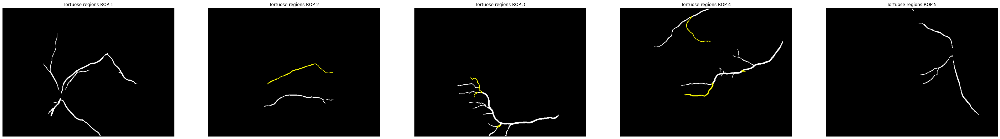

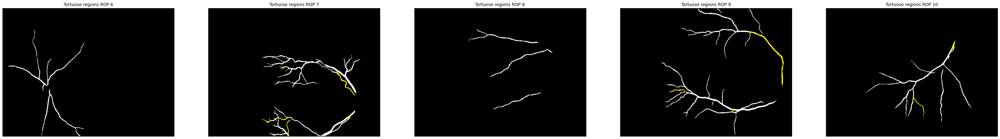

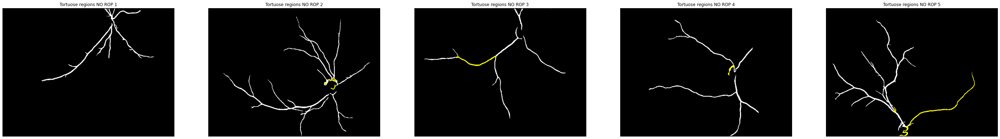

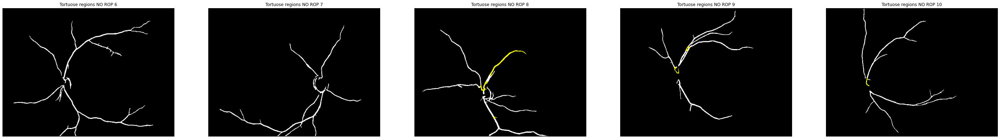

In [ ]:
fig = plt.figure(figsize=(50,50))
imgG(151,VA_to_R1,'Tortuose regions ROP 1')
imgG(152,VA_to_R2,'Tortuose regions ROP 2')
imgG(153,VA_to_R3,'Tortuose regions ROP 3')
imgG(154,VA_to_R4,'Tortuose regions ROP 4')
imgG(155,VA_to_R5,'Tortuose regions ROP 5')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_to_R6,'Tortuose regions ROP 6')
imgG(152,VA_to_R7,'Tortuose regions ROP 7')
imgG(153,VA_to_R8,'Tortuose regions ROP 8')
imgG(154,VA_to_R9,'Tortuose regions ROP 9')
imgG(155,VA_to_R10,'Tortuose regions ROP 10')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_to_NR1,'Tortuose regions NO ROP 1')
imgG(152,VA_to_NR2,'Tortuose regions NO ROP 2')
imgG(153,VA_to_NR3,'Tortuose regions NO ROP 3')
imgG(154,VA_to_NR4,'Tortuose regions NO ROP 4')
imgG(155,VA_to_NR5,'Tortuose regions NO ROP 5')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_to_NR6,'Tortuose regions NO ROP 6')
imgG(152,VA_to_NR7,'Tortuose regions NO ROP 7')
imgG(153,VA_to_NR8,'Tortuose regions NO ROP 8')
imgG(154,VA_to_NR9,'Tortuose regions NO ROP 9')
imgG(155,VA_to_NR10,'Tortuose regions NO ROP 10')

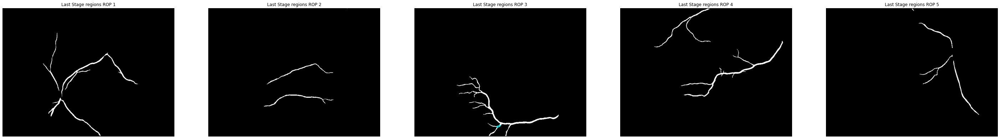

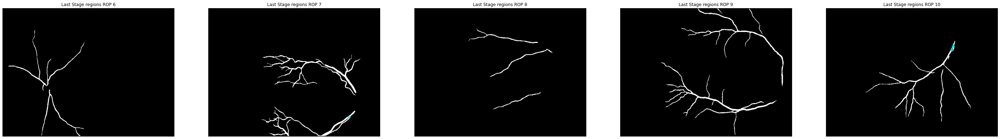

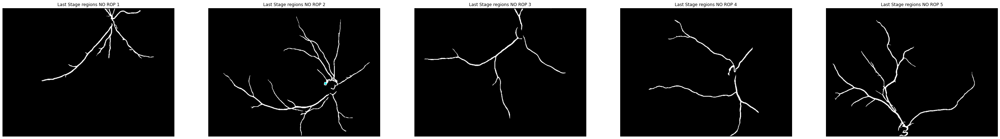

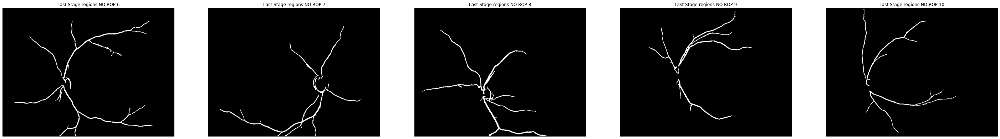

In [ ]:
fig = plt.figure(figsize=(50,50))
imgG(151,VA_TT_R1,'Last Stage regions ROP 1')
imgG(152,VA_TT_R2,'Last Stage regions ROP 2')
imgG(153,VA_TT_R3,'Last Stage regions ROP 3')
imgG(154,VA_TT_R4,'Last Stage regions ROP 4')
imgG(155,VA_TT_R5,'Last Stage regions ROP 5')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_TT_R6,'Last Stage regions ROP 6')
imgG(152,VA_TT_R7,'Last Stage regions ROP 7')
imgG(153,VA_TT_R8,'Last Stage regions ROP 8')
imgG(154,VA_TT_R9,'Last Stage regions ROP 9')
imgG(155,VA_TT_R10,'Last Stage regions ROP 10')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_TT_NR1,'Last Stage regions NO ROP 1')
imgG(152,VA_TT_NR2,'Last Stage regions NO ROP 2')
imgG(153,VA_TT_NR3,'Last Stage regions NO ROP 3')
imgG(154,VA_TT_NR4,'Last Stage regions NO ROP 4')
imgG(155,VA_TT_NR5,'Last Stage regions NO ROP 5')
fig = plt.figure(figsize=(50,50))
imgG(151,VA_TT_NR6,'Last Stage regions NO ROP 6')
imgG(152,VA_TT_NR7,'Last Stage regions NO ROP 7')
imgG(153,VA_TT_NR8,'Last Stage regions NO ROP 8')
imgG(154,VA_TT_NR9,'Last Stage regions NO ROP 9')
imgG(155,VA_TT_NR10,'Last Stage regions NO ROP 10')

### Flood

skeleton-id              2.000000
node-id-src            665.000000
node-id-dst           1411.000000
branch-distance          8.113887
branch-type              1.000000
mean-pixel-value         1.000000
stdev-pixel-value        0.000000
image-coord-src-0      390.666667
image-coord-src-1      247.666667
image-coord-dst-0      383.000000
image-coord-dst-1      247.000000
coord-src-0            390.666667
coord-src-1            247.666667
coord-dst-0            383.000000
coord-dst-1            247.000000
euclidean-distance       7.695598
Name: 42, dtype: float64
image    lenght        2175
image    tortuosity    1.11218564609973
image    thickness     3.6845977011494253
segment  lenght        507.9142135623731
segment  tortuosity    1.0543543424355146
segment  thickness     3.3333333333333335
skeleton-id             1.000000
node-id-src           344.000000
node-id-dst           577.000000
branch-distance        17.770741
branch-type             1.000000
mean-pixel-value        1.00000

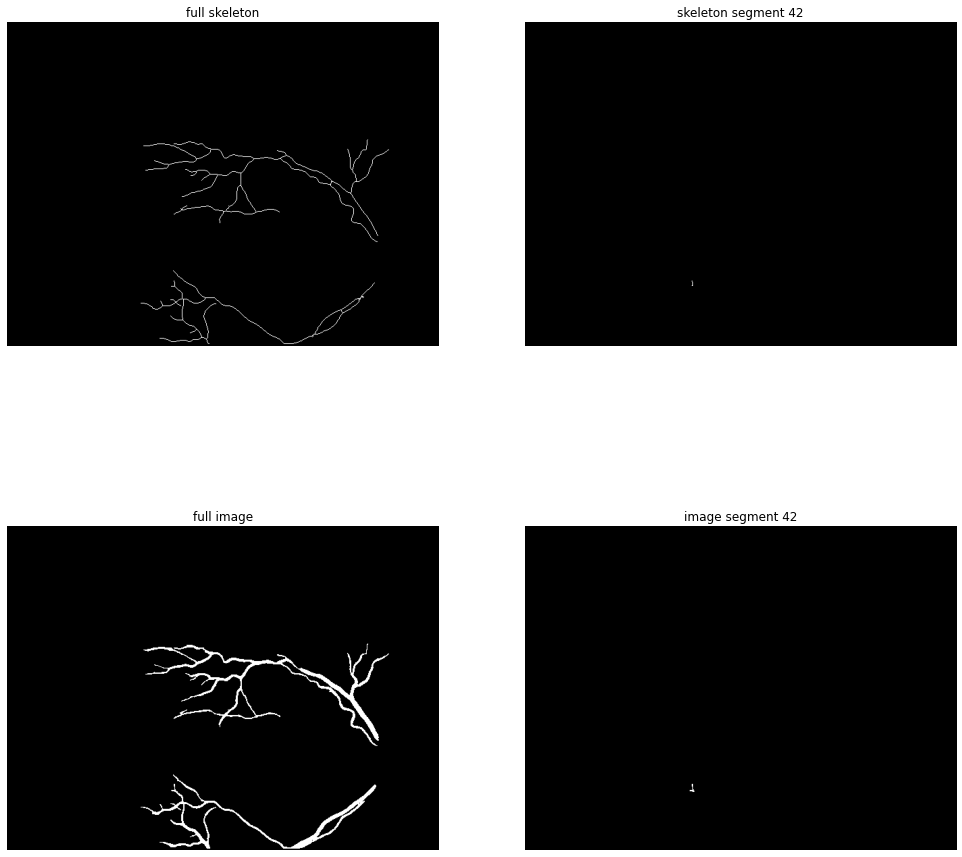

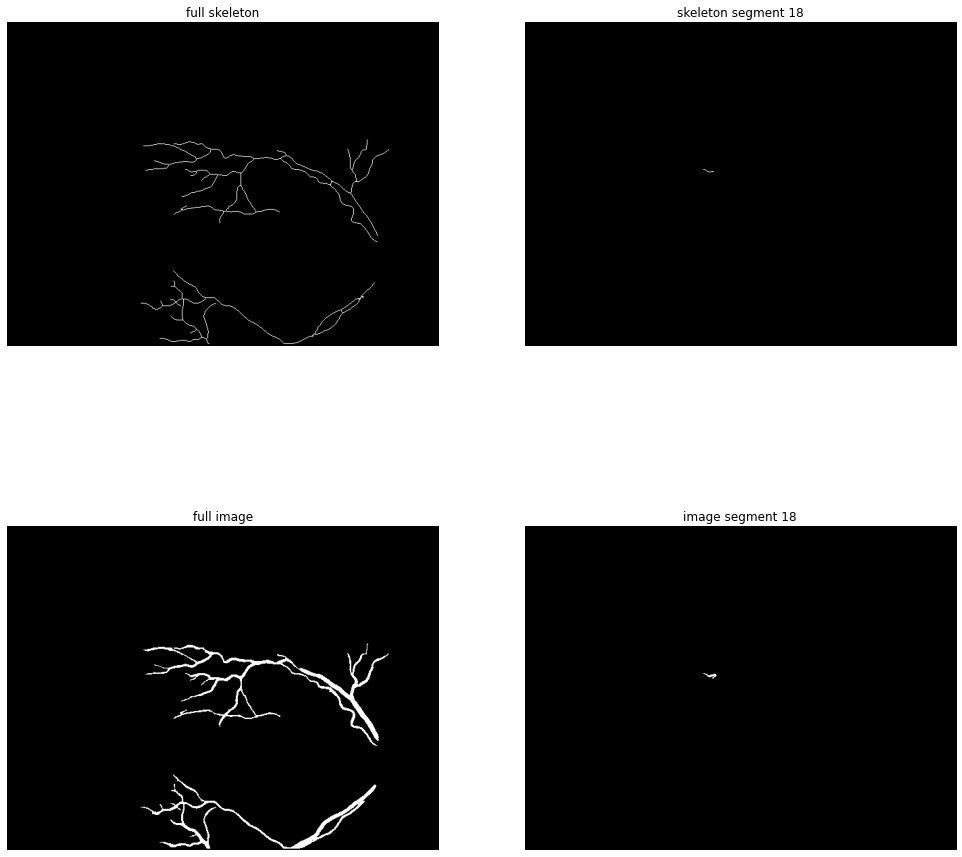

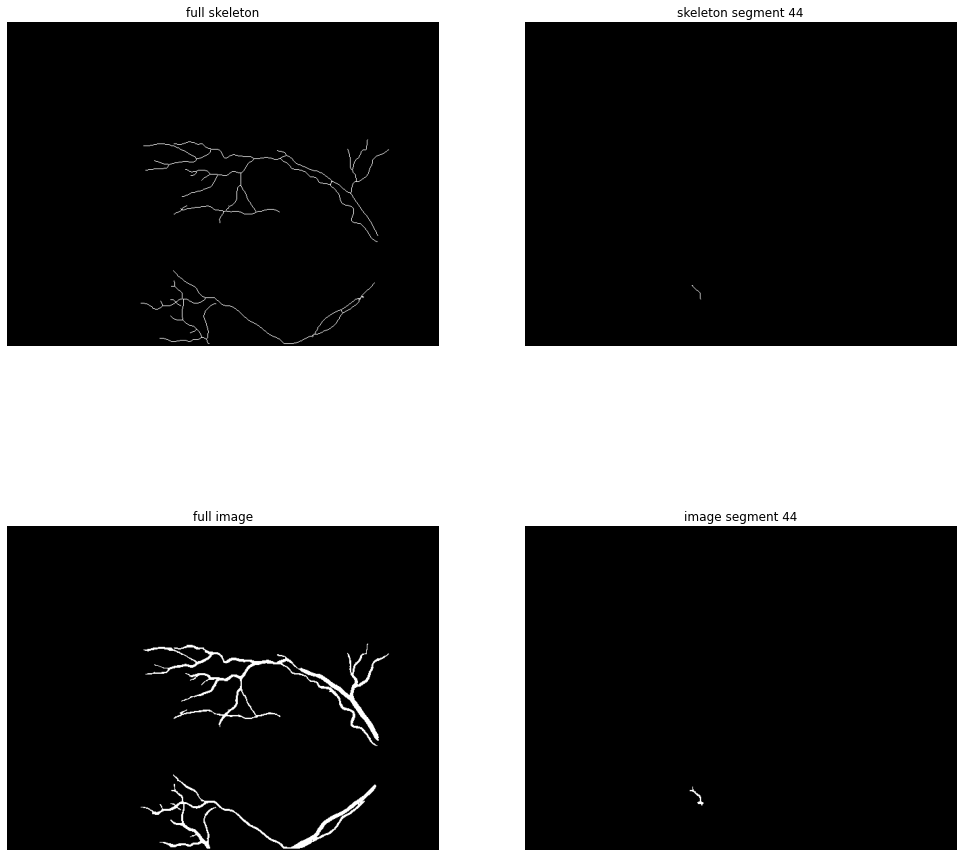

In [ ]:
#ske,seg,dil=region_description(NO_ROP_Segments[2],16)
#ske,seg,dil=region_description(NO_ROP_Segments[7],8)

ske1,seg1,dil1,start1=region_description(ROP_Segments[6],42)
ske2,seg2,dil2,start2=region_description(ROP_Segments[6],18)
ske3,seg3,dil3,start3=region_description(ROP_Segments[6],44)

In [ ]:
def Start_flood(ske,start):
  st_point = np.zeros((ske.shape[0],ske.shape[1]))
  st_point[start[0],start[1]]=1
  start_mat = dilation(st_point,((1,1,1),(1,0,1),(1,1,1)))
  mat = np.logical_and(ske,start_mat)
  mat_arr = np.zeros((ske.shape[0],ske.shape[1]))
  mat_arr[mat==True]=1
  dist=2
  start_flood = (0,0)
  for i in range(0,ske.shape[0]-1):
    for j in range(0,ske.shape[1]-1):
      if (mat_arr[i,j]>0):
        value = np.sqrt(((start[0]-i)**2)+((start[1]-j)**2))
        if  (value<dist):
          dist = value
          start_flood = (i,j)
  return start_flood

def SelectionArea (start,skeleton_sel,img):
  start_mov = Start_flood(skeleton_sel,start)
  dilated = dilation(skeleton_sel,disk(4))
  img_dil = np.logical_and(img,dilated)                               #select by dilation of segment
  arr_dil = np.zeros((skeleton_sel.shape[0],skeleton_sel.shape[1]))
  arr_dil[img_dil==True] = 1
  final = np.zeros((skeleton_sel.shape[0],skeleton_sel.shape[1]))
  fill = flood_fill(arr_dil,start_mov,0.9)
  final[fill==0.9] = 1                                                #select by flow to avoid overlapping
  return final

In [ ]:
dilated1 = dilation(ske1,disk(4))
dilated2 = dilation(ske2,disk(4))
dilated3 = dilation(ske3,disk(4))

img_dil1 = np.logical_and(ROP_Segments[6],dilated1)
img_dil2 = np.logical_and(ROP_Segments[6],dilated2)
img_dil3 = np.logical_and(ROP_Segments[6],dilated3)

st_point1 = np.zeros((ske1.shape[0],ske1.shape[1]))
st_point1[start1[0],start1[1]]=1
st_point2 = np.zeros((ske2.shape[0],ske2.shape[1]))
st_point2[start2[0],start2[1]]=1
st_point3 = np.zeros((ske3.shape[0],ske3.shape[1]))
st_point3[start3[0],start3[1]]=1

start_mat1 = dilation(st_point1,((1,1,1),(1,0,1),(1,1,1)))
start_mat2 = dilation(st_point2,((1,1,1),(1,0,1),(1,1,1)))
start_mat3 = dilation(st_point3,((1,1,1),(1,0,1),(1,1,1)))

start_mov1 = Start_flood(ske1,start1)
start_mov2 = Start_flood(ske2,start2)
start_mov3 = Start_flood(ske3,start3)

st_mov_point1 = np.zeros((ske1.shape[0],ske1.shape[1]))
st_mov_point1[start_mov1[0],start_mov1[1]]=1
st_mov_point2 = np.zeros((ske2.shape[0],ske2.shape[1]))
st_mov_point2[start_mov2[0],start_mov2[1]]=1
st_mov_point3 = np.zeros((ske3.shape[0],ske3.shape[1]))
st_mov_point3[start_mov3[0],start_mov3[1]]=1

final1=SelectionArea(start1,ske1,ROP_Segments[6])
final2=SelectionArea(start2,ske2,ROP_Segments[6])
final3=SelectionArea(start3,ske3,ROP_Segments[6])

overlapping: 2
value: 1.4142135623730951
value: 1.0
overlapping: 1
value: 1.0
overlapping: 2
value: 1.0
value: 1.4142135623730951
overlapping: 2
value: 1.4142135623730951
value: 1.0
overlapping: 1
value: 1.0
overlapping: 2
value: 1.0
value: 1.4142135623730951


In [ ]:
print("start seg:",start1,"  start flood:",start_mov1)
print("start seg:",start2,"  start flood:",start_mov2)
print("start seg:",start3,"  start flood:",start_mov3)

start seg: (390, 247)   start flood: (390, 248)
start seg: (221, 279)   start flood: (221, 278)
start seg: (390, 247)   start flood: (390, 248)


In [ ]:
A = np.sum(final1==1)
L = np.sum(ske1==1)
T = A/L
print("Area:",A,"  Lenght:",L,"  Tthickness:",T)
A = np.sum(final2==1)
L = np.sum(ske2==1)
T = A/L
print("Area:",A,"  Lenght:",L,"  Tthickness:",T)
A = np.sum(final3==1)
L = np.sum(ske3==1)
T = A/L
print("Area:",A,"  Lenght:",L,"  Tthickness:",T)

Area: 30   Lenght: 9   Tthickness: 3.3333333333333335
Area: 22   Lenght: 6   Tthickness: 3.6666666666666665
Area: 307098   Lenght: 23   Tthickness: 13352.08695652174


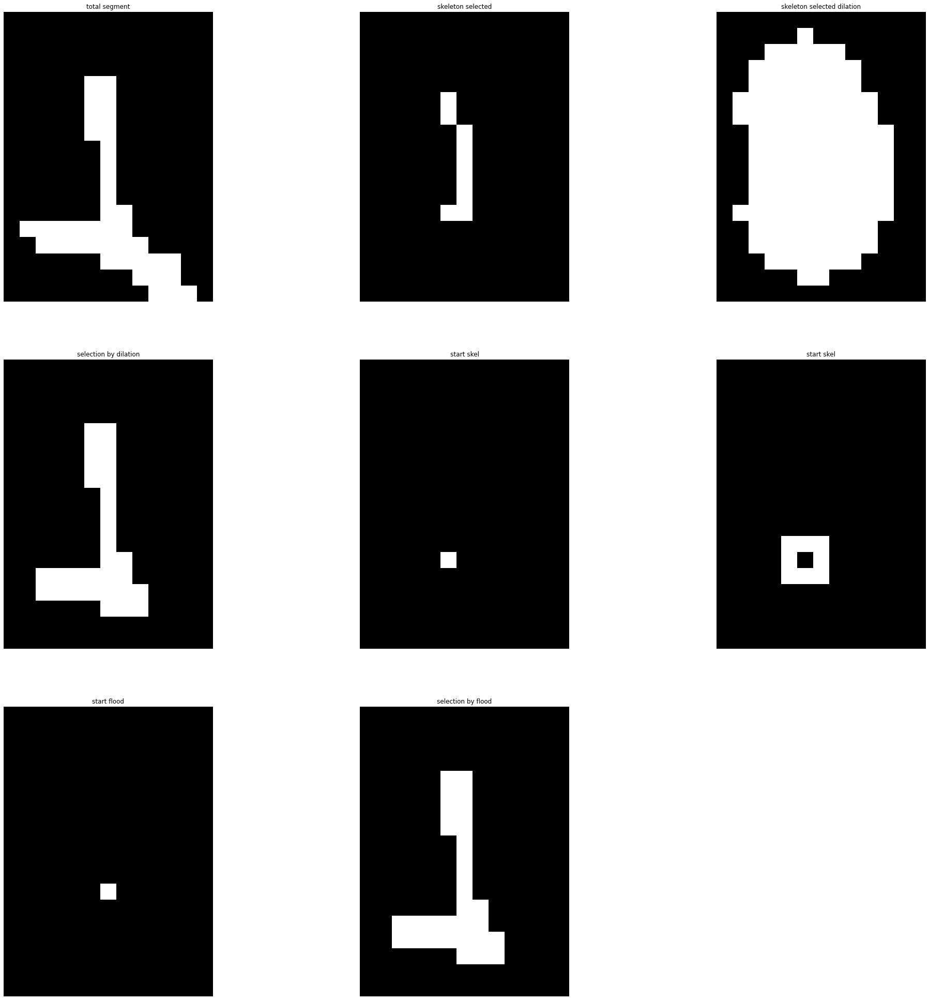

In [ ]:
fig = plt.figure(figsize=(35,35))
imgG(331,ROP_Segments[6][378:396,242:255],'total segment')
imgG(332,ske1[378:396,242:255],'skeleton selected')
imgG(333,dilated1[378:396,242:255],'skeleton selected dilation')
imgG(334,img_dil1[378:396,242:255],'selection by dilation')
imgG(335,st_point1[378:396,242:255],'start skel')
imgG(336,start_mat1[378:396,242:255],'start skel')
imgG(337,st_mov_point1[378:396,242:255],'start flood')
imgG(338,final1[378:396,242:255],'selection by flood')

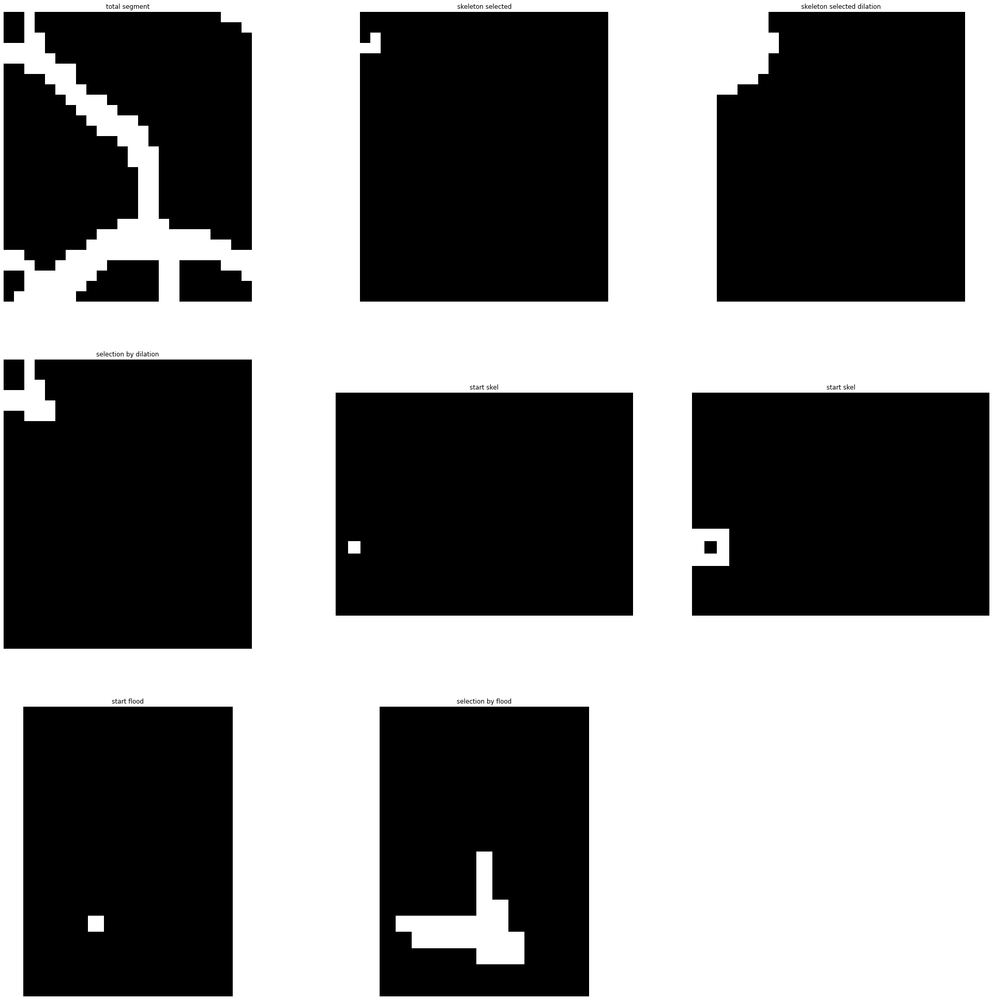

In [ ]:
fig = plt.figure(figsize=(35,35))
imgG(331,ROP_Segments[6][388:416,246:270],'total segment')
imgG(332,ske2[388:416,246:270],'skeleton selected')
imgG(333,dilated2[388:416,246:270],'skeleton selected dilation')
imgG(334,img_dil2[388:416,246:270],'selection by dilation')
imgG(335,st_point2[378:396,246:270],'start skel')
imgG(336,start_mat2[378:396,246:270],'start skel')
imgG(337,st_mov_point2[378:396,242:255],'start flood')
imgG(338,final2[378:396,242:255],'selection by flood')

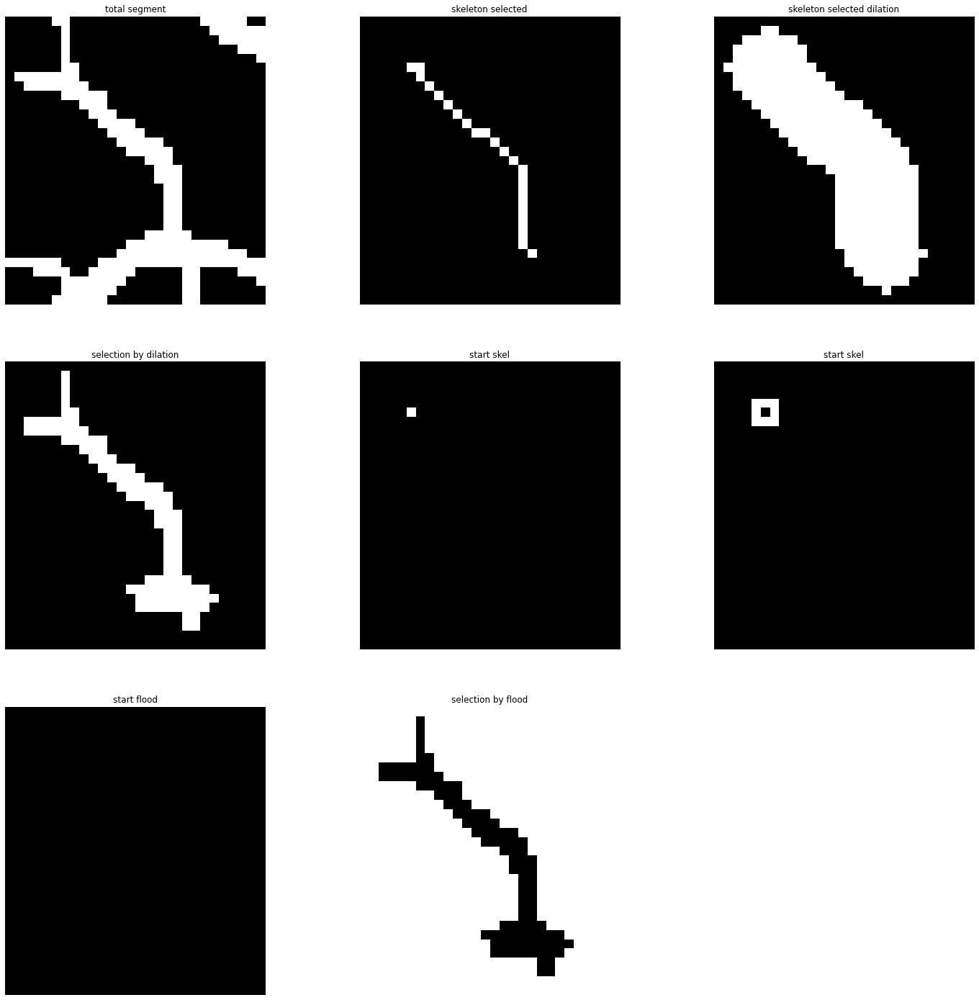

In [ ]:
fig = plt.figure(figsize=(25,25))
imgG(331,ROP_Segments[6][385:416,242:270],'total segment')
imgG(332,ske3[385:416,242:270],'skeleton selected')
imgG(333,dilated3[385:416,242:270],'skeleton selected dilation')
imgG(334,img_dil3[385:416,242:270],'selection by dilation')
imgG(335,st_point3[385:416,242:270],'start skel')
imgG(336,start_mat3[385:416,242:270],'start skel')
imgG(337,st_mov_point3[385:416,242:270],'start flood')
imgG(338,final3[385:416,242:270],'selection by flood')

In [ ]:
seg_arr = np.zeros((seg.shape[0],seg.shape[1]))
seg_arr[seg==True] = 1
final = np.zeros((seg.shape[0],seg.shape[1]))
fill = flood_fill(seg_arr, start1, 0.9)
final[fill==0.9] = 1

In [ ]:
((1,1,1),(1,1,1))

((1, 1, 1), (1, 1, 1))

In [ ]:
st_point = np.zeros((seg1.shape[0],seg1.shape[1]))
st_point[start1[0],start1[1]]=1
st_mat = dilation(st_point,((1,1,1),(1,0,1),(1,1,1)))
mat = np.logical_and(ske1,st_point)


In [ ]:
start1_mov

(389, 248)

In [ ]:
print(start)
print(start_flood)

(390, 247)
(389, 248)


### Gradient

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters
from skimage.data import camera
from skimage.util import compare_images

In [ ]:
image = ske.copy()
gradx = filters.sobel_h(image)
grady = filters.sobel_v(image)
gradM = np.sqrt(np.power(gradx,2)+np.power(grady,2))
grad_angle = np.arctan2(grady,gradx)

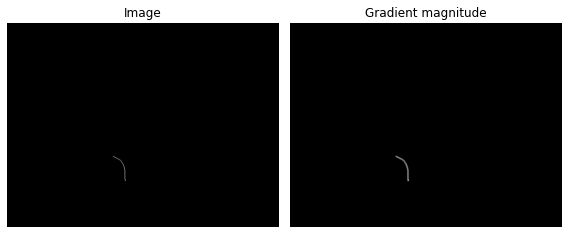

In [ ]:
fig, axes = plt.subplots(ncols=2, sharex=True, sharey=True,figsize=(8, 4))
axes[0].imshow(image, cmap=plt.cm.gray)
axes[0].set_title('Image')
axes[1].imshow(gradM, cmap=plt.cm.gray)
axes[1].set_title('Gradient magnitude')

for ax in axes:
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from skimage.filters import gaussian
from skimage import img_as_ubyte
import plotly.express as px


import numpy as np
fig = px.imshow(gradM)
fig.show()

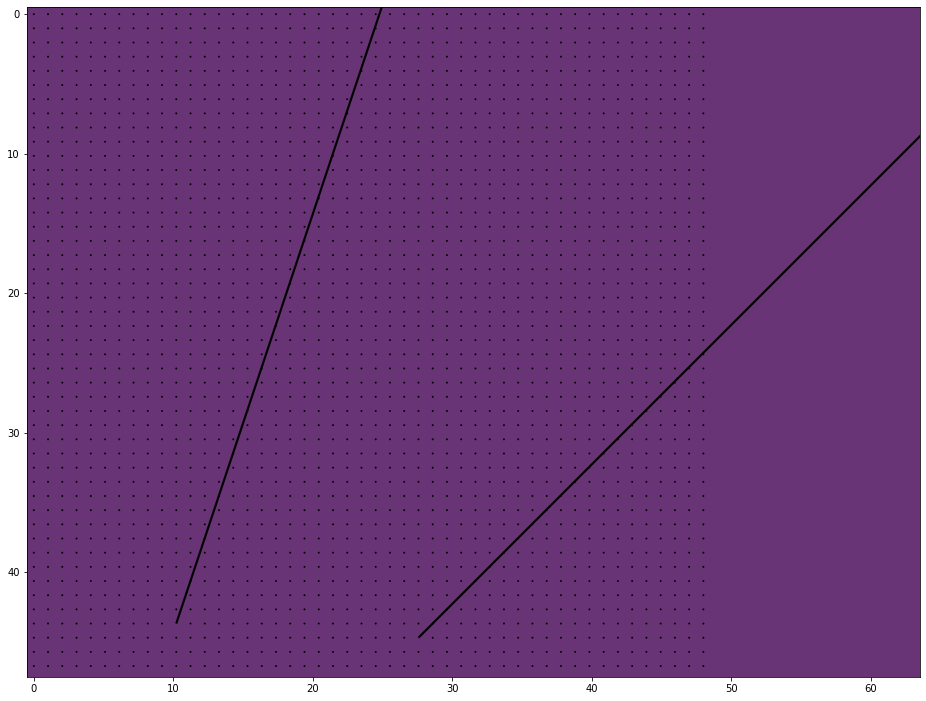

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


NX = gradx1.shape[0]
NY = grady1.shape[1]

x,y = np.meshgrid(np.linspace(0,NX,NX),np.linspace(0,NY,NY))

fig = plt.figure(figsize=(16,16))
plt.quiver(x,y,grady1,gradx1,angles='xy')
plt.imshow(image1,alpha=0.8)
plt.show()

### OTHER 

In [ ]:
fig = plt.figure(figsize=(15,12))
draw.overlay_euclidean_skeleton_2d(seg1,branch_data1,skeleton_color_source="skeleton-id",skeleton_colormap="tab20b");
fig = plt.figure(figsize=(15,12))
draw.overlay_euclidean_skeleton_2d(seg2,branch_data2,skeleton_color_source="skeleton-id",skeleton_colormap="tab20b")
fig = plt.figure(figsize=(15,12))
draw.overlay_euclidean_skeleton_2d(seg3,branch_data3,skeleton_color_source="skeleton-id",skeleton_colormap="tab20b")

In [ ]:
#D1.sort_values("tortuosity").head(10)

In [ ]:
import seaborn as sns
#sns.scatterplot(x="branch-distance",y="curving",data=D1)
sns.histplot(data=D1,x="tortuosity")

In [ ]:
branch_data1.sort_values("branch-type",ascending=False).head(10)

In [ ]:
branch_data1.groupby("branch-type").count()

In [ ]:
branch_data1.sort_values("branch-distance",ascending=False)

In [ ]:
import numpy as np
a = np.zeros((10, 10))
a[4, 4] = 1
a

In [ ]:
b = np.zeros((10, 10))
b[3, 3] = 1
b[4, 3] = 1
b[5, 4] = 1
b[6, 4] = 1
b[7, 5] = 1
b[8, 5] = 1
b

In [ ]:
from scipy import ndimage
ndimage.binary_dilation(a).astype(a.dtype)

In [ ]:
struct3 = np.array([[False,False,False],[True,True,True],[False,False,False]])
struct3

In [ ]:
ndimage.binary_dilation(b, structure=struct3).astype(a.dtype)

In [ ]:
im=rgb2gray(I1)
im_ga = exposure.adjust_gamma(im, 5)
fig = plt.figure(figsize=(17,17))
imgG(121,im,'image 1')
imgG(122,im_ga,'image 1')

In [ ]:
im[M1]=np.mean(im)

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(121,im,'image 1')

In [ ]:
from skimage.filters import median
from skimage.morphology import disk
from skimage.filters import median
med = median(im, disk(5))
im_res = np.reshape(med,(im.shape[0]*im.shape[1]))
tr = np.quantile(im_res[im_res>0],0.5)
im_bw = med > tr
fig = plt.figure(figsize=(17,17))
imgG(121,med,'image 1')
imgG(122,im_bw,'image 1')


In [ ]:
im_res_cor=np.where(im_res<np.quantile(im_res,0.15),np.mean(im_res[im_res>0]),im_res)
im_cor = np.reshape(im_res_cor,(I1.shape[0],I1.shape[1]))
fig = plt.figure(figsize=(17,17))
imgG(121,im_cor,'image 1')

In [ ]:
np.quantile(im_res,0.5)

In [ ]:
import matplotlib.pyplot as plt
from skimage import data
from skimage.filters import threshold_otsu
im=rgb2gray(I1)
thresh = threshold_otsu(im_cor)
binary = im_cor > thresh
fig = plt.figure(figsize=(17,17))
imgG(121,im_cor,'image 1')
imgG(122,binary,'image 1')


In [ ]:

binary[binary==True]=1
binary[binary==False]=0

fig = make_subplots(rows=1, cols=3, shared_xaxes = 'all',shared_yaxes = 'all')
fig.add_trace(go.Image(z=I1), 1, 1)
fig.add_trace(go.Heatmap(z=im), 1, 2)
fig.add_trace(go.Heatmap(z=binary), 1, 3)
fig.update_layout(height=1000, width=1000, title_text="Subplots with Shared Axes")
fig.show()

In [ ]:
I1_I_G.shape

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(121,I1_I_G[100:400,50:140],'Background 1')
imgG(122,I1_fin[100:400,50:140],'Background 1')

In [ ]:
tr = np.quantile(I1_I_G[100:400,50:140],0.15)
im_res = I1_I_G[100:400,50:140] > tr
fig = plt.figure(figsize=(12,12))
imgG(121,I1_I_G[100:400,50:140],'Background 1')
imgG(122,im_res,'Background 1')

In [ ]:
#!pip install tk
#!pip install cv
import matplotlib.pyplot as plt
import skimage as sk 
import skimage.io as io
import cv2
import numpy as np

In [ ]:
img=I1_I_G[100:400,50:140].copy()

In [ ]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)

plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])

plt.show()

In [ ]:
laplacian = cv2.Laplacian(img, cv2.CV_8U)
sobelx = cv2.Sobel(img,cv2.CV_8U,1,0,ksize=5)
sobely = cv2.Sobel(img,cv2.CV_8U,0,1,ksize=5)

laplacian64 = cv2.Laplacian(img, cv2.CV_64F)
sobelx64 = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
sobely64 = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)

laplacian = np.uint8(np.absolute(laplacian64))
sobelx = np.uint8(np.absolute(sobelx64))
sobely = np.uint8(np.absolute(sobely64))

plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])


In [ ]:
from skimage.filters import threshold_local
thresh = threshold_local(I1_I_G[100:400,50:140], 7, 'median')
binary = thresh<0.35
fig = plt.figure(figsize=(8,8))
imgG(131,I1_I_G[100:400,50:140],'Background 1')
imgG(132,thresh,'Background 1')
imgG(133,binary,'Background 1')
np.min(thresh)

In [ ]:
from skimage.filters import threshold_local
thresh = threshold_local(I2_I_G[:,0:320], 7, 'median')
binary = thresh<0.35
fig = plt.figure(figsize=(8,8))
imgG(131,I2_I_G[:,0:320],'Background 1')
imgG(132,thresh,'Background 1')
imgG(133,binary,'Background 1')
np.min(thresh)
I2_I_G.shape

In [ ]:
I4_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/9_test.jpg"
M4_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/mask/9_test_mask.gif"
P4_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/9_pred.jpg"

In [ ]:
gamma = 1.8
CL = 0.15
I4 = sk.io.imread(I4_Path)                                           #image
M4 = sk.io.imread(M4_Path)                                           #mask
P4 = sk.io.imread(P4_Path)                                           #prediction
I4_I = 255-I4                                                       #inverted colours
I4_G = exposure.adjust_gamma(I4, gamma)                              #gamma filter
I4_I_G = exposure.adjust_gamma(I4_I, gamma)                              
I4_A = exposure.equalize_adapthist(I4_G, clip_limit=CL)            #CLAHE filter
I4_I_A = exposure.equalize_adapthist(I4_I_G, clip_limit=CL)            


NameError: ignored

In [ ]:
min_x = -1
min_y = -1
max_x = -1
max_y = -1
for i in range(P4.shape[0]):
  for j in range (P4.shape[1]):
    if (P4[i,j]>1):
      if (min_x==-1):
        min_x = i
        max_x = i
        min_y = j
        max_y = j
      if (min_x>i):
        min_x = i
      if (max_x<i):
        max_x = i
      if (min_y>j):
        min_y = j
      if (max_y<j):
        max_y = j

I4_BG = I1.copy()
I4_BG_A = I4_A.copy()
I4_BG_I = I4_I_A.copy()
for i in range(min_x,max_x):
  for j in range (min_y,max_y):
    I4_BG[i,j] = 0
    I4_BG_A[i,j] = 0
    I4_BG_I[i,j] = 1

In [ ]:
I4_G = rgb2gray(I4_BG)
I4_I_G = rgb2gray(I4_BG_I)
fig = plt.figure(figsize=(17,17))
imgG(131,I4[:,0:320],'Background 1')
imgG(132,I4_I_G[:,0:320],'Background 1')


In [ ]:
from skimage.filters import threshold_local
thresh = threshold_local(I4_I_G[:,0:320], 7, 'median')
binary = thresh<0.35
fig = plt.figure(figsize=(8,8))
imgG(131,I4_I_G[:,0:320],'Background 1')
imgG(132,thresh,'Background 1')
imgG(133,binary,'Background 1')
np.min(thresh)
I4_I_G.shape

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(131,I1_BG,'Background 1')
imgG(132,I1_BG_A,'Background adjusted 1')

In [ ]:
r = 3
I1_BG_eq = I1_BG.copy()
I1_BG_A_eq = I1_BG_A.copy()
for i in range(I1_BG.shape[0]):
  for j in range (I1_BG.shape[1]):
    if ((I1_BG[i,j]!=[0,0,0]) and (I1_BG[i,j,0]<I1_BG[i,j,1]+r) and (I1_BG[i,j,0]>I1_BG[i,j,1]-r) and (I1_BG[i,j,2]<I1_BG[i,j,1]+r) and (I1_BG[i,j,2]>I1_BG[i,j,1]-r) and (I1_BG[i,j,2]<I1_BG[i,j,0]+r) and (I1_BG[i,j,2]>I1_BG[i,j,0]-r):
      I1_BG_eq[i,j,0] = 255
      I1_BG_eq[i,j,1] = 255
      I1_BG_eq[i,j,2] = 255
    else:
      I1_BG_eq[i,j,0] = 0
      I1_BG_eq[i,j,1] = 0
      I1_BG_eq[i,j,2] = 0      
    if (I1_BG[i,j]!=[0,0,0]) and (I1_BG_A[i,j,0]<I1_BG_A[i,j,1]+r) and (I1_BG_A[i,j,0]>I1_BG_A[i,j,1]-r) and (I1_BG_A[i,j,2]<I1_BG_A[i,j,1]+r) and (I1_BG_A[i,j,2]>I1_BG_A[i,j,1]-r) and (I1_BG_A[i,j,2]<I1_BG_A[i,j,0]+r) and (I1_BG_A[i,j,2]>I1_BG_A[i,j,0]-r):
      I1_BG_A_eq[i,j,0] = 255
      I1_BG_A_eq[i,j,1] = 255
      I1_BG_A_eq[i,j,2] = 255
    else:
      I1_BG_A_eq[i,j,0] = 0
      I1_BG_A_eq[i,j,1] = 0
      I1_BG_A_eq[i,j,2] = 0  

fig = plt.figure(figsize=(17,17))
imgG(131,I1_BG_eq,'Background 1')
imgG(132,I1_BG_A_eq,'Background adjusted 1')

In [ ]:
I1_BG[0,0]==[0,0,0]

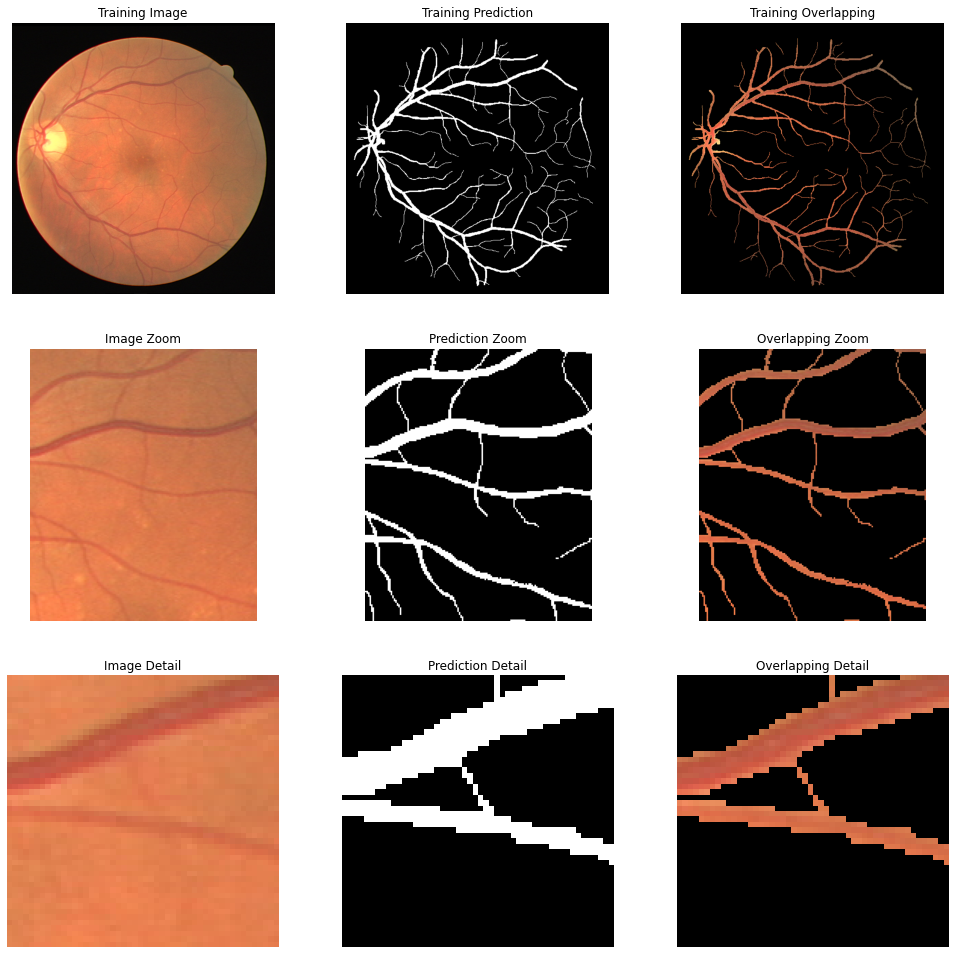

In [ ]:
from PIL import Image
Tr_Img_Path = "/content/gdrive/MyDrive/test_orobix/DRIVE/training/images/21_training.tif"
Tr_Pre_Path = "/content/gdrive/MyDrive/test_orobix/DRIVE/training/1st_manual/21_manual1.gif"
Tr_Img = np.array(Image.open(Tr_Img_Path))
Tr_Pre = np.array(Image.open(Tr_Pre_Path))
Tr_OL = Tr_Img.copy()
Tr_OL[Tr_Pre<130]=0
fig = plt.figure(figsize=(17,17))
imgG(331,Tr_Img,'Training Image')
imgG(332,Tr_Pre,'Training Prediction')
imgG(333,Tr_OL,'Training Overlapping')
imgG(334,Tr_Img[80:260,200:350],'Image Zoom')
imgG(335,Tr_Pre[80:260,200:350],'Prediction Zoom')
imgG(336,Tr_OL[80:260,200:350],'Overlapping Zoom')
imgG(337,Tr_Img[130:180,200:250],'Image Detail')
imgG(338,Tr_Pre[130:180,200:250],'Prediction Detail')
imgG(339,Tr_OL[130:180,200:250],'Overlapping Detail')

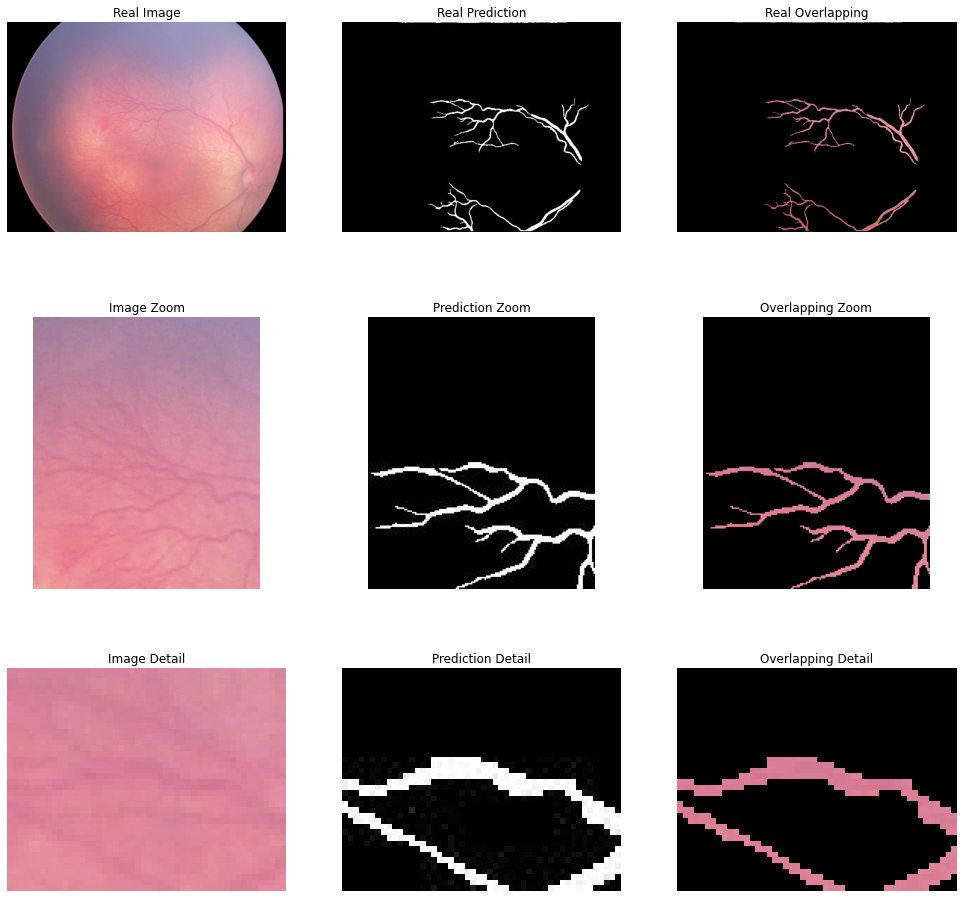

In [ ]:
from PIL import Image
Re_Img_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/1_test.jpg"
Re_Pre_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_CLEAN/7_pred.jpg"
Re_Img = np.array(Image.open(Re_Img_Path))
Re_Pre = np.array(Image.open(Re_Pre_Path))
Re_OL = Re_Img.copy()
Re_OL[Re_Pre<130]=0
fig = plt.figure(figsize=(17,17))
imgG(331,Re_Img,'Real Image')
imgG(332,Re_Pre,'Real Prediction')
imgG(333,Re_OL,'Real Overlapping')
imgG(334,Re_Img[80:260,200:350],'Image Zoom')
imgG(335,Re_Pre[80:260,200:350],'Prediction Zoom')
imgG(336,Re_OL[80:260,200:350],'Overlapping Zoom')
imgG(337,Re_Img[160:200,250:300],'Image Detail')
imgG(338,Re_Pre[160:200,250:300],'Prediction Detail')
imgG(339,Re_OL[160:200,250:300],'Overlapping Detail')

In [ ]:
Tr_Pre_I = Tr_Pre.copy()
Tr_Pre_I[Tr_Pre>0]=0
Tr_Pre_I[Tr_Pre<255]=255

fig = plt.figure(figsize=(17,17))
imgG(231,Tr_Img[0:50,200:350],'Train Image Top')
imgG(232,Tr_Pre[0:50,200:350],'Train Prediction Top')
imgG(233,Tr_Pre_I[0:50,200:350],'Train Prediction Inverted Top')
imgG(234,Tr_Img[430:480,200:350],'Train Image Bottom')
imgG(235,Tr_Pre[430:480,200:350],'Train Prediction Bottom')
imgG(236,Tr_Pre_I[430:480,200:350],'Train Prediction Inverted Bottom')

NameError: ignored

In [ ]:
Re_N_Img_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/1_test.jpg"
Re_N_Pre_Path = "/content/gdrive/MyDrive/test_orobix/orobix_colab/pred_REAL/7_pred.jpg"
Re_N_Img = np.array(Image.open(Re_N_Img_Path))
Re_N_Pre = np.array(Image.open(Re_N_Pre_Path))

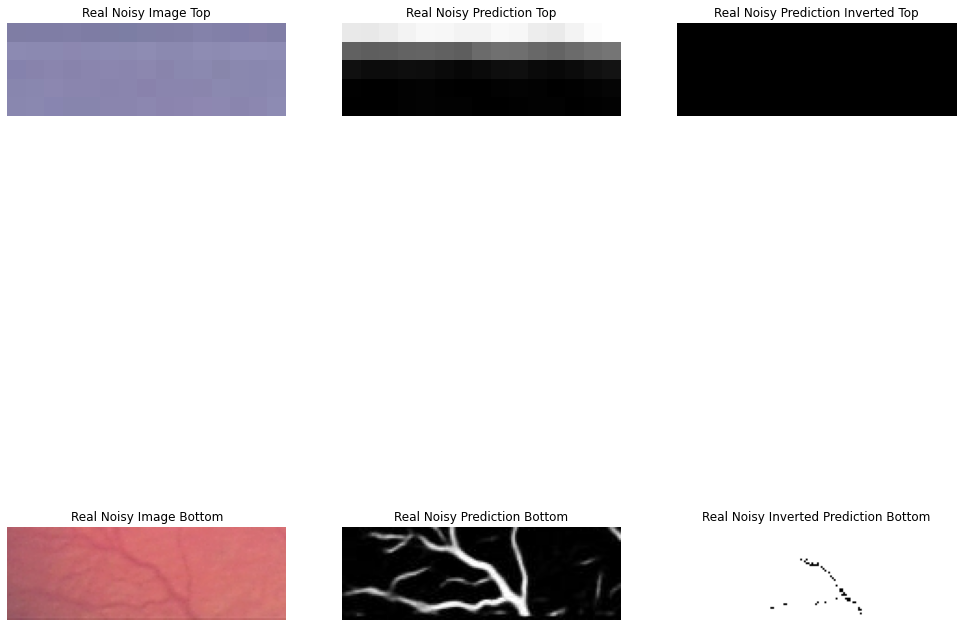

In [ ]:
Re_N_Pre_I = Re_N_Pre.copy()
Re_N_Pre_I[Re_N_Pre>0]=0
Re_N_Pre_I[Re_N_Pre<255]=255

fig = plt.figure(figsize=(17,17))
imgG(231,Re_N_Img[0:5,265:280],'Real Noisy Image Top')
imgG(232,Re_N_Pre[0:5,265:280],'Real Noisy Prediction Top')
imgG(233,Re_N_Pre_I[0:5,265:280],'Real Noisy Prediction Inverted Top')
imgG(234,Re_N_Img[430:480,200:350],'Real Noisy Image Bottom')
imgG(235,Re_N_Pre[430:480,200:350],'Real Noisy Prediction Bottom')
imgG(236,Re_N_Pre_I[430:480,200:350],'Real Noisy Inverted Prediction Bottom')

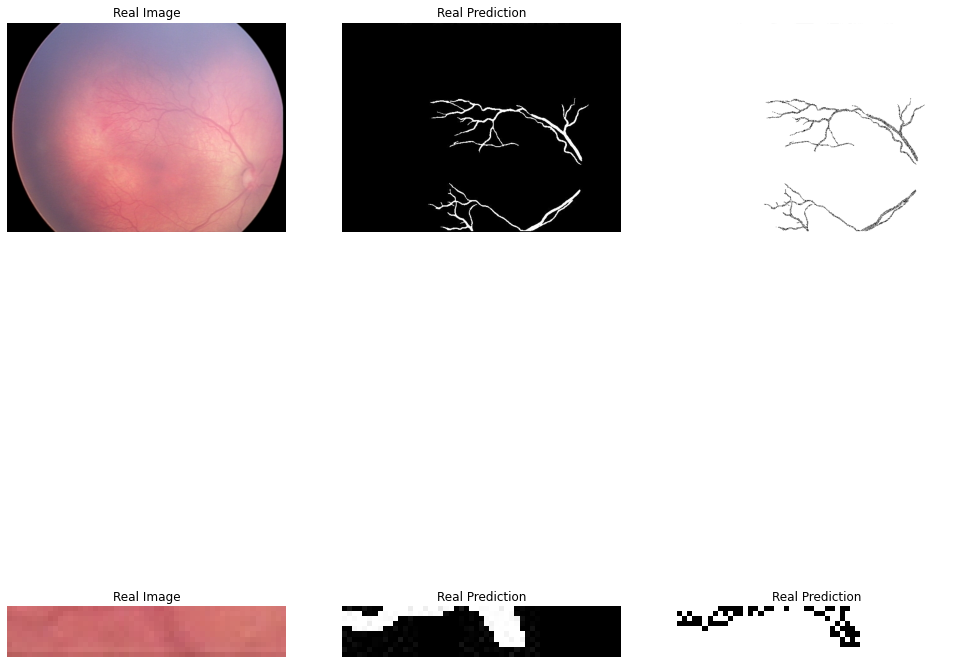

In [ ]:
Re_Pre_I = Re_Pre.copy()
Re_Pre_I[Re_Pre>0]=0
Re_Pre_I[Re_Pre<255]=255

fig = plt.figure(figsize=(17,17))
imgG(231,Re_Img,'Real Image')
imgG(232,Re_Pre,'Real Prediction')
imgG(233,Re_Pre_I,'')
imgG(234,Re_Img[470:480,265:320],'Real Image')
imgG(235,Re_Pre[470:480,265:320],'Real Prediction')
imgG(236,Re_Pre_I[470:480,265:320],'Real Prediction')

In [ ]:
from PIL import Image
Img_1_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/1_test.jpg"
Img_2_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/2_test.jpg"
Img_3_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/3_test.jpg"
Img_4_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/4_test.jpg"
Img_5_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/5_test.jpg"
Img_6_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/6_test.jpg"
Img_7_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/7_test.jpg"
Img_8_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/8_test.jpg"
Img_9_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/9_test.jpg"
Img_10_Path = "/content/gdrive/MyDrive/test_orobix/REAL/test/images/10_test.jpg"

In [ ]:
Img_1 = np.array(Image.open(Img_1_Path))
Img_2 = np.array(Image.open(Img_2_Path))
Img_3 = np.array(Image.open(Img_3_Path))
Img_4 = np.array(Image.open(Img_4_Path))
Img_5 = np.array(Image.open(Img_5_Path))
Img_6 = np.array(Image.open(Img_6_Path))
Img_7 = np.array(Image.open(Img_7_Path))
Img_8 = np.array(Image.open(Img_8_Path))
Img_9 = np.array(Image.open(Img_9_Path))
Img_10 = np.array(Image.open(Img_10_Path))

In [ ]:
ROP_1 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/7_test.jpg')
ROP_2 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/4_test.jpg')
ROP_3 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/10_test.jpg')
ROP_4 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/6_test.jpg')
ROP_5 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/3_test.jpg')
ROP_6 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/8_test.jpg')
ROP_7 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/5_test.jpg')
ROP_8 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/1_test.jpg')
ROP_9 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/2_test.jpg')
ROP_10 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/test/images/9_test.jpg')
NO_ROP_1 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/1_test.jpg')
NO_ROP_2 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/2_test.jpg')
NO_ROP_3 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/3_test.jpg')
NO_ROP_4 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/4_test.jpg')
NO_ROP_5 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/5_test.jpg')
NO_ROP_6 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/6_test.jpg')
NO_ROP_7 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/7_test.jpg')
NO_ROP_8 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/8_test.jpg')
NO_ROP_9 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/9_test.jpg')
NO_ROP_10 = sk.io.imread('/content/gdrive/MyDrive/test_orobix/REAL/NO_ROP/image/10_test.jpg')

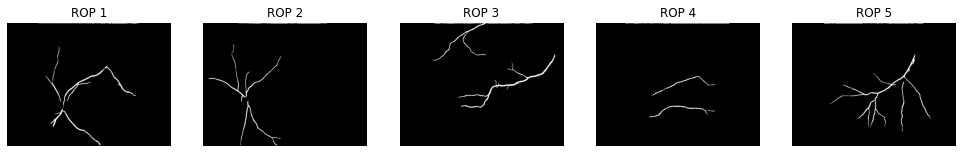

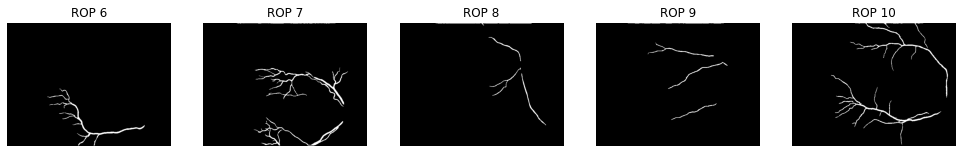

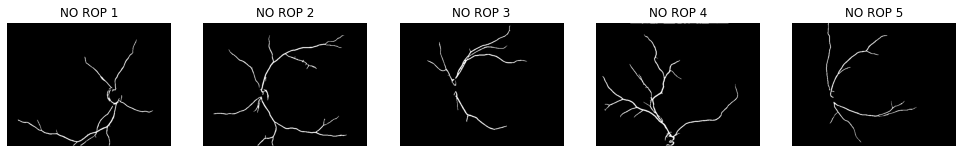

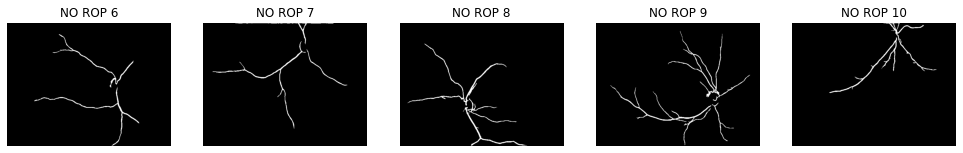

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(151,ROP_Segments[0],'ROP 1')
imgG(152,ROP_Segments[1],'ROP 2')
imgG(153,ROP_Segments[2],'ROP 3')
imgG(154,ROP_Segments[3],'ROP 4')
imgG(155,ROP_Segments[4],'ROP 5')
fig = plt.figure(figsize=(17,17))
imgG(151,ROP_Segments[5],'ROP 6')
imgG(152,ROP_Segments[6],'ROP 7')
imgG(153,ROP_Segments[7],'ROP 8')
imgG(154,ROP_Segments[8],'ROP 9')
imgG(155,ROP_Segments[9],'ROP 10')
fig = plt.figure(figsize=(17,17))
imgG(151,NO_ROP_Segments[0],'NO ROP 1')
imgG(152,NO_ROP_Segments[1],'NO ROP 2')
imgG(153,NO_ROP_Segments[2],'NO ROP 3')
imgG(154,NO_ROP_Segments[3],'NO ROP 4')
imgG(155,NO_ROP_Segments[4],'NO ROP 5')
fig = plt.figure(figsize=(17,17))
imgG(151,NO_ROP_Segments[5],'NO ROP 6')
imgG(152,NO_ROP_Segments[6],'NO ROP 7')
imgG(153,NO_ROP_Segments[7],'NO ROP 8')
imgG(154,NO_ROP_Segments[8],'NO ROP 9')
imgG(155,NO_ROP_Segments[9],'NO ROP 10')

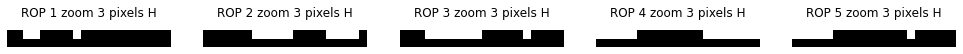

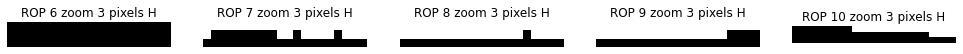

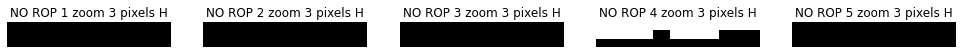

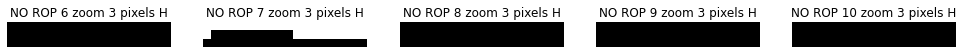

In [ ]:
fig = plt.figure(figsize=(17,17))
imgG(151,ROP_Segments[0][0:3,280:300],'ROP 1 zoom 3 pixels H')
imgG(152,ROP_Segments[1][0:3,245:265],'ROP 2 zoom 3 pixels H')
imgG(153,ROP_Segments[2][0:3,280:300],'ROP 3 zoom 3 pixels H')
imgG(154,ROP_Segments[3][0:3,280:300],'ROP 4 zoom 3 pixels H')
imgG(155,ROP_Segments[4][0:3,270:290],'ROP 5 zoom 3 pixels H')
fig = plt.figure(figsize=(17,17))
imgG(151,ROP_Segments[5][0:3,280:300],'ROP 6 zoom 3 pixels H')
imgG(152,ROP_Segments[6][0:3,255:275],'ROP 7 zoom 3 pixels H')
imgG(153,ROP_Segments[7][0:3,280:300],'ROP 8 zoom 3 pixels H')
imgG(154,ROP_Segments[8][0:3,280:300],'ROP 9 zoom 3 pixels H')
imgG(155,ROP_Segments[9][0:3,235:265],'ROP 10 zoom 3 pixels H')
fig = plt.figure(figsize=(17,17))
imgG(151,NO_ROP_Segments[0][0:3,225:245],'NO ROP 1 zoom 3 pixels H')
imgG(152,NO_ROP_Segments[1][0:3,225:245],'NO ROP 2 zoom 3 pixels H')
imgG(153,NO_ROP_Segments[2][0:3,225:245],'NO ROP 3 zoom 3 pixels H')
imgG(154,NO_ROP_Segments[3][0:3,225:245],'NO ROP 4 zoom 3 pixels H')
imgG(155,NO_ROP_Segments[4][0:3,225:245],'NO ROP 5 zoom 3 pixels H')
fig = plt.figure(figsize=(17,17))
imgG(151,NO_ROP_Segments[5][0:3,225:245],'NO ROP 6 zoom 3 pixels H')
imgG(152,NO_ROP_Segments[6][0:3,255:275],'NO ROP 7 zoom 3 pixels H')
imgG(153,NO_ROP_Segments[7][0:3,225:245],'NO ROP 8 zoom 3 pixels H')
imgG(154,NO_ROP_Segments[8][0:3,225:245],'NO ROP 9 zoom 3 pixels H')
imgG(155,NO_ROP_Segments[9][0:3,225:245],'NO ROP 10 zoom 3 pixels H')